## Lets get started..
**Import relevent libraries and check Python version**
We have tested with Python Version: 3.6.3

In [1]:
%matplotlib inline

from Resources import helpers
import matplotlib.pyplot as plt
import numpy as np
import scipy as sp
import pandas as pd
import pysal as ps
import geopandas as gpd
import shapefile
# You may need palettable: pip install palettable
from osgeo import ogr #dont use pip, but instead 'conda install gdal'
from pylab import *
import sys
import platform
import zipfile
import os
from datetime import datetime

from mpl_toolkits.basemap import Basemap 
# conda install -c conda-forge basemap 
# conda install -c conda-forge basemap-data-hires
from lxml import etree
import matplotlib.cm as cm
from matplotlib.colors import Normalize
from matplotlib.collections import PatchCollection
from shapely.geometry import Point, Polygon, MultiPoint, MultiPolygon
from shapely.prepared import prep
from pysal.esda.mapclassify import Natural_Breaks as nb
from descartes import PolygonPatch
import fiona
from itertools import chain
import pickle
from descartes import PolygonPatch

print(sys.version_info)
print("Python Version: " + str(platform.python_version()))

sys.version_info(major=3, minor=6, micro=4, releaselevel='final', serial=0)
Python Version: 3.6.4


**Lets unzip the data!**

In [2]:
cwd = os.getcwd()  # Get the current working directory (cwd)
files = os.listdir(cwd)  # Get all the files in that directory
print("Files in '%s': %s" % (cwd, files))

Files in '/Users/bryder/polybox/PhD/Workshop/Spatial-Workshop': ['Tutorial-Master-Nice-Maps.ipynb', '.DS_Store', 'Tutorial-Master.ipynb', 'test.prj', 'Resources', 'Tutorial-Skeleton.ipynb', 'README.md', 'map.pickle', '.gitattributes', 'test.dbf', '.ipynb_checkpoints', 'test.cpg', 'test.shp', '.git', 'test.shx', 'Data', 'Spatial-Data.zip']


In [3]:
with zipfile.ZipFile("./Spatial-Data.zip","r") as zip_ref:
    zip_ref.extractall()

**Set some useful parameters**

In [4]:
# Some useful parameters that we don't need to set later
pickle_map_name = 'map.pickle'
params = {'legend.fontsize': 20}
plt.rcParams.update(params)
tfs = 20

# Save the clean dataset to a new file for reuse later
clean_link = "./Data/nyc_census_tract_features_v3_export_clean"
clean_shp_link = clean_link + ".shp"

**And lets define some useful functions which are needed later**

In [5]:
# analyse_and_transform_wrapper: analyse_and_transform normalises variables with BoxCox
# this function wraps around to use with multiple values  
def analyse_and_transform_wrapper(names,data):
    for n in names:
        data[n] = helpers.analyse_and_transform(data[n])
    return data

def plotArcGisMap(variable, bin_n, poly, cmap='YlOrRd'):
    f, ax = plt.subplots(1, figsize=(11, 11))
    
    map = pickle.load(open(pickle_map_name,'rb')) 
    map.arcgisimage(service='ESRI_Imagery_World_2D', xpixels=1000, zorder=0)

    patches = poly['poly'].map(lambda x: PolygonPatch(x, edgecolor='white', linewidth=0.75, zorder=10))
    patches = PatchCollection(patches, match_original=True, zorder=10)
    
    cmap = plt.get_cmap(cmap)
    norm = Normalize()

    min_value = min(variable)
    max_value = max(variable)
    
    # impose our colour map onto the patch collection
    patches.set_facecolor(cmap(norm(variable)))    
    patches.set_alpha(0.5)
    ax.add_collection(patches)
    
    mappable = cm.ScalarMappable(cmap=cmap)
    mappable.set_array([])
    mappable.set_clim(min_value, max_value)
    colorbar = plt.colorbar(mappable,fraction=0.0475, pad=0.01)
    colorbar.set_ticks(np.linspace(start=min_value, stop=max_value, num=bin_n))
    colorbar.set_ticklabels(np.round(np.linspace(start=min_value, stop=max_value, num=bin_n)),1)

    map.drawmapscale(
        coords[0] + 0.48, coords[1] + 0.025,
        coords[0], coords[1], 10.,
        barstyle='fancy', labelstyle='simple',
        fillcolor1='w', fillcolor2='#555555',
        fontcolor='#FFFFFF',
        zorder=5)

    plt.show()
    
def plotArcGisCentroidMap(poly, centroids, cmap='YlOrRd'):
    f, ax = plt.subplots(1, figsize=(20, 20))
    
    map = pickle.load(open(pickle_map_name,'rb')) 
    map.arcgisimage(service='ESRI_Imagery_World_2D', xpixels=1000, zorder=0)

    patches = poly['poly'].map(lambda x: PolygonPatch(x, edgecolor='black', linewidth=0.75, zorder=10))
    patches = PatchCollection(patches, match_original=True, zorder=5)
    
        # impose our colour map onto the patch collection
    patches.set_facecolor('w')    
    patches.set_alpha(0.8)
    ax.add_collection(patches)
    
    plt.plot(centroids[:,0], centroids[:,1],'.', color='b', zorder=10)

    map.drawmapscale(
        coords[0] + 0.48, coords[1] + 0.025,
        coords[0], coords[1], 10.,
        barstyle='fancy', labelstyle='simple',
        fillcolor1='w', fillcolor2='#555555',
        fontcolor='#FFFFFF',
        zorder=5)

    plt.show()
    
def plotArcGisNeighbourMap(poly, centroids, grouping, cmap='YlOrRd'):
    f, ax = plt.subplots(1, figsize=(20, 20))
    
    map = pickle.load(open(pickle_map_name,'rb')) 
    map.arcgisimage(service='ESRI_Imagery_World_2D', xpixels=1000, zorder=0)

    patches = poly['poly'].map(lambda x: PolygonPatch(x, edgecolor='black', linewidth=0.75, zorder=10))
    patches = PatchCollection(patches, match_original=True, zorder=5)
    
    # impose our colour map onto the patch collection
    patches.set_facecolor('w')    
    patches.set_alpha(0.8)
    ax.add_collection(patches)
    
    plt.plot(centroids[:,0], centroids[:,1],'.', color='b', zorder=10)
    for k,neighs in grouping.neighbors.items():
        origin = centroids[k]
        for neigh in neighs:
            segment = centroids[[k,neigh]]
            plt.plot(segment[:,0], segment[:,1], '-', zorder=10)

    map.drawmapscale(
        coords[0] + 0.48, coords[1] + 0.025,
        coords[0], coords[1], 10.,
        barstyle='fancy', labelstyle='simple',
        fillcolor1='w', fillcolor2='#555555',
        fontcolor='#FFFFFF',
        zorder=5)

    plt.show()

fiona_shp = fiona.open(clean_shp_link)
bds = fiona_shp.bounds
fiona_shp.close()
extra = 0.01
ll = (bds[0], bds[1])
ur = (bds[2], bds[3])
coords = list(chain(ll, ur))
w, h = coords[2] - coords[0], coords[3] - coords[1]
map = Basemap(resolution='c', # c, l, i, h, f or None
                projection='tmerc',
                lat_0=40.655198,
                lon_0=-74.030345,
                ellps = 'WGS84',
                epsg=3627,
                llcrnrlon=coords[0] - extra * w,
                llcrnrlat=coords[1] - extra + 0.01 * h,
                urcrnrlon=coords[2] + extra * w,
                urcrnrlat=coords[3] + extra + 0.01 * h,)
pickle.dump(map,open(pickle_map_name,'wb'),-1)  # pickle it 


## Data
**We need to import the data that we're using - this should be included in the git project**

In [6]:
shp_link = "./Data/nyc_census_tract_features_v3_export.shp"
dataset = gpd.read_file(shp_link)

# Interested to see the data? Uncomment and run the command below
#dataset

# Interested in the full list of variables? Uncomment and run the command below
#dataset.columns.tolist()

**Lets see what area this data looks like!**

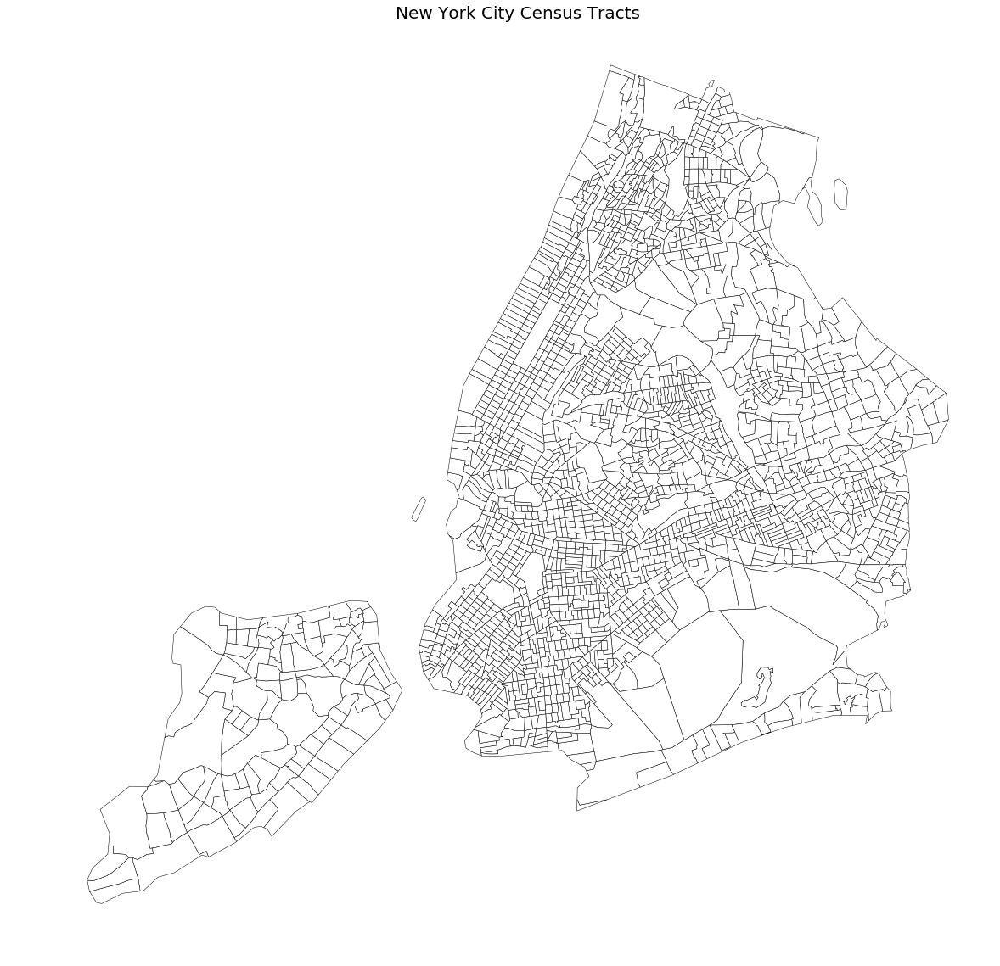

In [7]:
f, ax = plt.subplots(1, figsize=(20, 20))
dataset.plot(ax=ax, linewidth=0.5, color='white', edgecolor='black')
plt.title('New York City Census Tracts', fontsize=tfs)
ax.set_axis_off()
plt.show()

**Great, we have a visualisation of the census tracts in New York! Now lets take a look at the distribution of our dependent variable, average AirBnB price per night, for each of these tracts:**

{'boxes': [<matplotlib.lines.Line2D at 0x1a1ca38438>],
 'caps': [<matplotlib.lines.Line2D at 0x1a1a4f3668>,
 'fliers': [<matplotlib.lines.Line2D at 0x1a1c610748>],
 'means': [],
 'medians': [<matplotlib.lines.Line2D at 0x1a1c610160>],
 'whiskers': [<matplotlib.lines.Line2D at 0x1a1ca388d0>,
  <matplotlib.lines.Line2D at 0x1a1ca389b0>]}

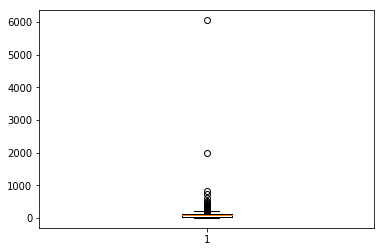

In [8]:
plt.boxplot(dataset.avg_listin, showfliers=True)

**There are some clear outliers, lets limit these to take a closer look**

{'boxes': [<matplotlib.lines.Line2D at 0x1a1bb84198>],
 'caps': [<matplotlib.lines.Line2D at 0x1a1c97d358>,
 'fliers': [],
 'means': [],
 'medians': [<matplotlib.lines.Line2D at 0x1a1c97d710>],
 'whiskers': [<matplotlib.lines.Line2D at 0x1a1bb84630>,
  <matplotlib.lines.Line2D at 0x1a1bb84be0>]}

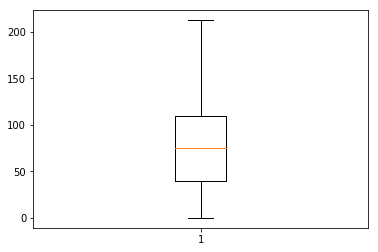

In [9]:
plt.boxplot(dataset.avg_listin, showfliers=False)

**Interestingly, we see here that there are some census tracts which have an average price per night of $0, this is probably a data quality issue.. so lets compare this to the number of listings per tract.**

In [10]:
error_tracts = dataset[dataset.avg_listin == 0]
print("Max Number of AirBnB Listings: " + str(max(error_tracts.count_list)))
print("Min Number of AirBnB Listings: " + str(min(error_tracts.count_list)))

Max Number of AirBnB Listings: 0.0
Min Number of AirBnB Listings: 0.0


**So we observe that there are some tracts which don't have any AirBnB listings, in these cases the price per night in the dataset is 0. In some cases it might be acceptable to include these tracts in the analysis, but in our case it will appear that some areas are free to stay in - where as the reality is that there are no places available.**

**Lets clean this dataset up!**

{'boxes': [<matplotlib.lines.Line2D at 0x1a1c940550>],
 'caps': [<matplotlib.lines.Line2D at 0x1a1c63a160>,
 'fliers': [],
 'means': [],
 'medians': [<matplotlib.lines.Line2D at 0x1a1c63aac8>],
 'whiskers': [<matplotlib.lines.Line2D at 0x1a1c940908>,
  <matplotlib.lines.Line2D at 0x1a1c940e48>]}

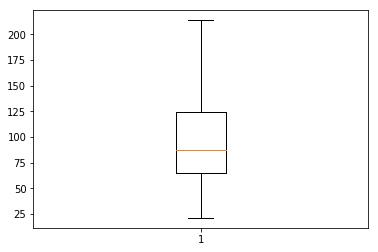

In [11]:
# Remove locations where there are no AirBnb listings

dataset_clean = dataset[dataset.count_list != 0]

# lets check what the distribution looks like now:
plt.boxplot(dataset_clean.avg_listin, showfliers=False)


**Much better! So that we can align this dataset to a map of New York lets convert the projection to include longitude and latitude coordinates, and then save the file to be reused later: **

In [12]:
# We convert the dataset to lon-lat projection
dataset_clean = dataset_clean.to_crs({'proj':'longlat', 'ellps':'WGS84'})
dataset_clean.to_file(clean_shp_link, driver='ESRI Shapefile')

** Plotting Data onto a Map **

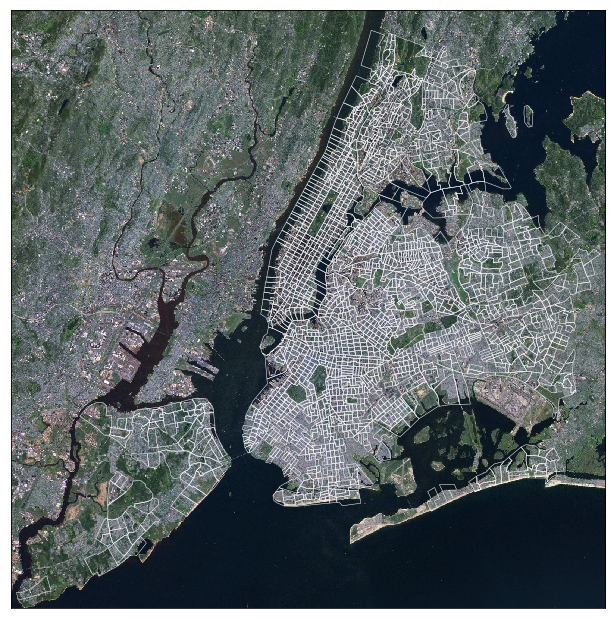

In [13]:
f, ax = plt.subplots(1, figsize=(11, 11))

map = pickle.load(open(pickle_map_name,'rb')) 

map.arcgisimage(service='ESRI_Imagery_World_2D', 
                xpixels=1000, 
                zorder=0)

map.readshapefile(shapefile=clean_link, 
                   name='tracts', 
                   linewidth=0.5, 
                   color='white', 
                   zorder=1)

plt.show()

**There's an issue here - where one record is read in twice, we need to drop this!**

In [14]:
# We can save this new dataset for displaying data on the maps later
map_tracts = map.tracts.copy()
print(len(map_tracts))
map_tracts_info = pd.DataFrame.from_records(map.tracts_info)
for i in range(0,len(map_tracts_info)):
    if map_tracts_info['RINGNUM'][i]==2:
        print(i)
        map_tracts.pop(i)
map_tracts_info = map_tracts_info[map_tracts_info['RINGNUM']!=2]
map_tracts_poly = pd.DataFrame({'poly': [Polygon(xy) for xy in map_tracts]})

1685
814


**Lets add some color to the map!**

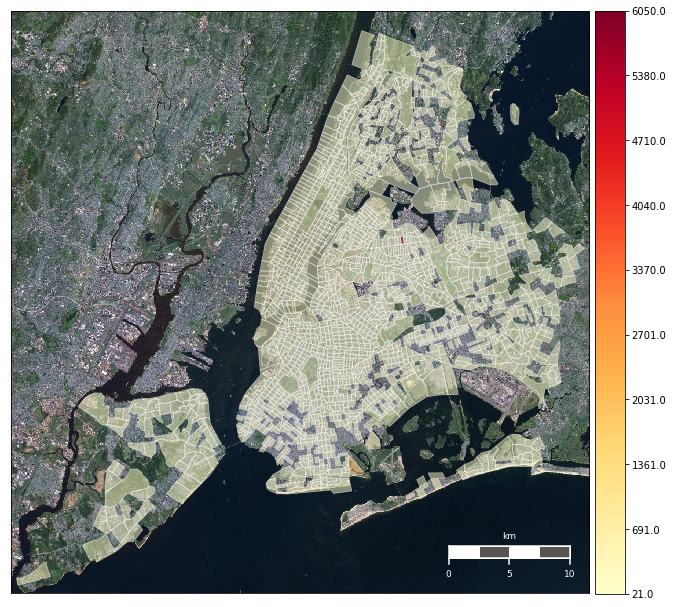

In [15]:
plotArcGisMap(variable=map_tracts_info['avg_listin'].values,
              bin_n=10,
              poly=map_tracts_poly,
              cmap='YlOrRd')

(array([ 190.,  159.,  156.,  170.,  169.,  166.,  169.,  168.,  168.,  169.]),
 array([ 0. ,  0.9,  1.8,  2.7,  3.6,  4.5,  5.4,  6.3,  7.2,  8.1,  9. ]),
 <a list of 10 Patch objects>)

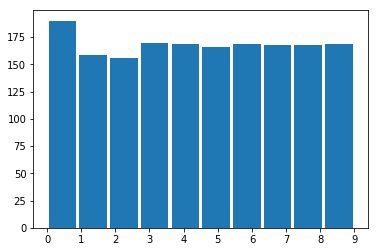

In [16]:
bin_n=10

map_tracts_info_quantiles = map_tracts_info[['avg_listin']].apply(ps.Quantiles.make(k=bin_n))
plt.hist(map_tracts_info_quantiles, rwidth=0.9)

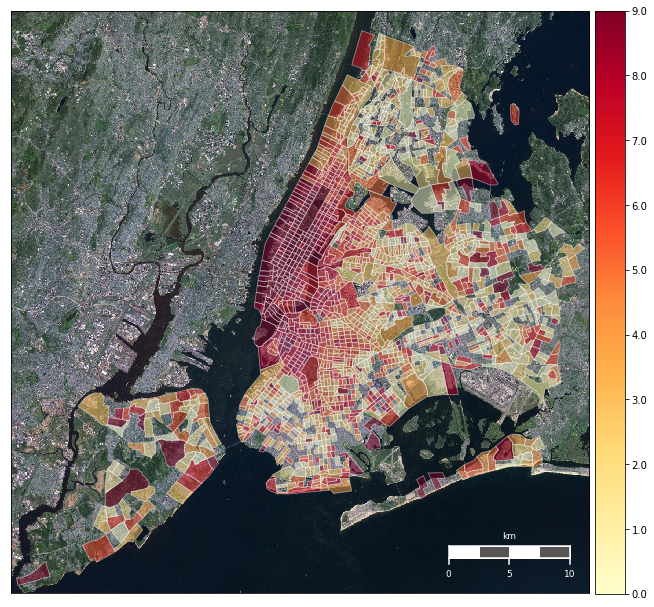

In [17]:
plotArcGisMap(variable=map_tracts_info_quantiles['avg_listin'].values,
              bin_n=bin_n,
              poly=map_tracts_poly,
              cmap='YlOrRd')

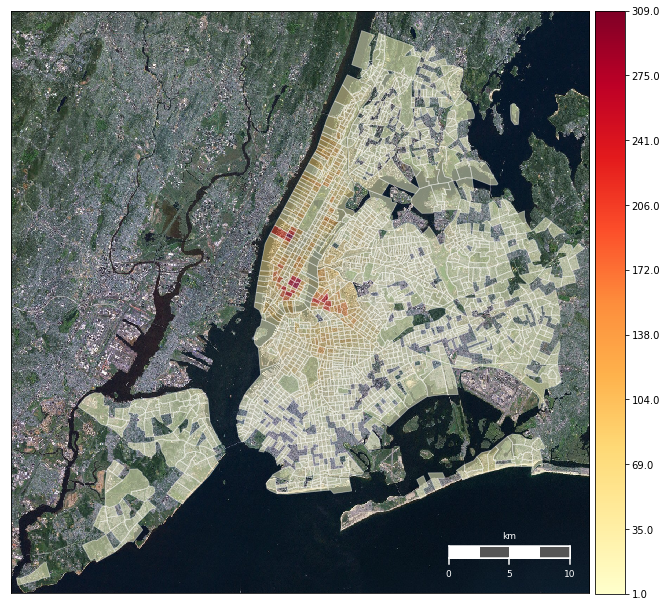

In [18]:
plotArcGisMap(variable=map_tracts_info['count_list'].values,
              bin_n=10,
              poly=map_tracts_poly,
              cmap='YlOrRd')

(array([ 333.,  206.,  143.,  166.,    0.,  185.,  151.,  165.,  169.,  166.]),
 array([ 0. ,  0.8,  1.6,  2.4,  3.2,  4. ,  4.8,  5.6,  6.4,  7.2,  8. ]),
 <a list of 10 Patch objects>)

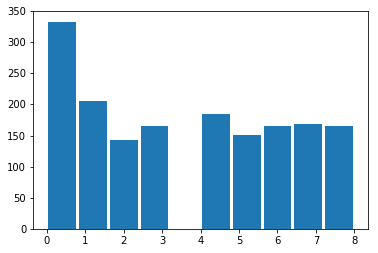

In [19]:
map_tracts_info_quantiles = map_tracts_info[['count_list']].apply(ps.Quantiles.make(k=10))
plt.hist(map_tracts_info_quantiles, rwidth=0.9)

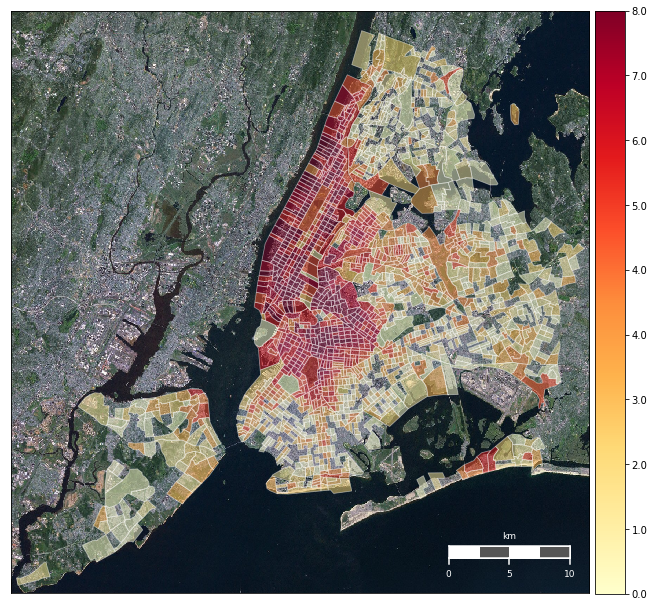

In [20]:
plotArcGisMap(variable=map_tracts_info_quantiles['count_list'].values,
              bin_n=bin_n,
              poly=map_tracts_poly,
              cmap='YlOrRd')

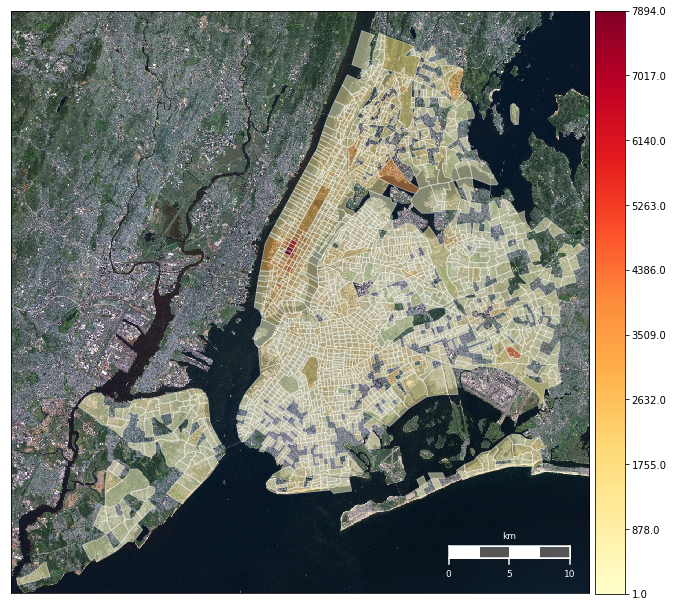

In [21]:
plotArcGisMap(variable=map_tracts_info['incidents_'].values,
              bin_n=bin_n,
              poly=map_tracts_poly,
              cmap='YlOrRd')

(array([ 171.,  166.,  169.,  169.,  168.,  168.,  168.,  168.,  168.,  169.]),
 array([ 0. ,  0.9,  1.8,  2.7,  3.6,  4.5,  5.4,  6.3,  7.2,  8.1,  9. ]),
 <a list of 10 Patch objects>)

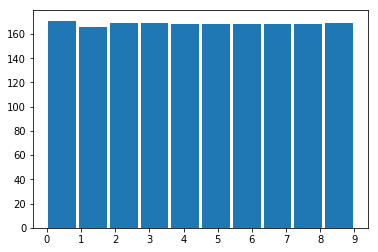

In [22]:
map_tracts_info_quantiles = map_tracts_info[['incidents_']].apply(ps.Quantiles.make(k=bin_n))
plt.hist(map_tracts_info_quantiles, rwidth=0.9)

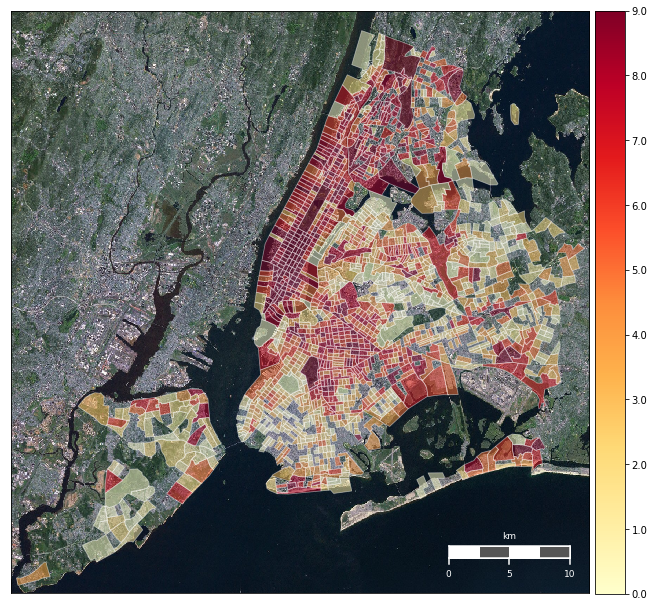

In [23]:
plotArcGisMap(variable=map_tracts_info_quantiles['incidents_'].values,
              bin_n=bin_n,
              poly=map_tracts_poly,
              cmap='YlOrRd')

**Let's also generate the central points for each of these census tracts...**

In [24]:
centroids_clean = np.array([list([tract.centroid.x,tract.centroid.y]) for tract in map_tracts_poly['poly']])

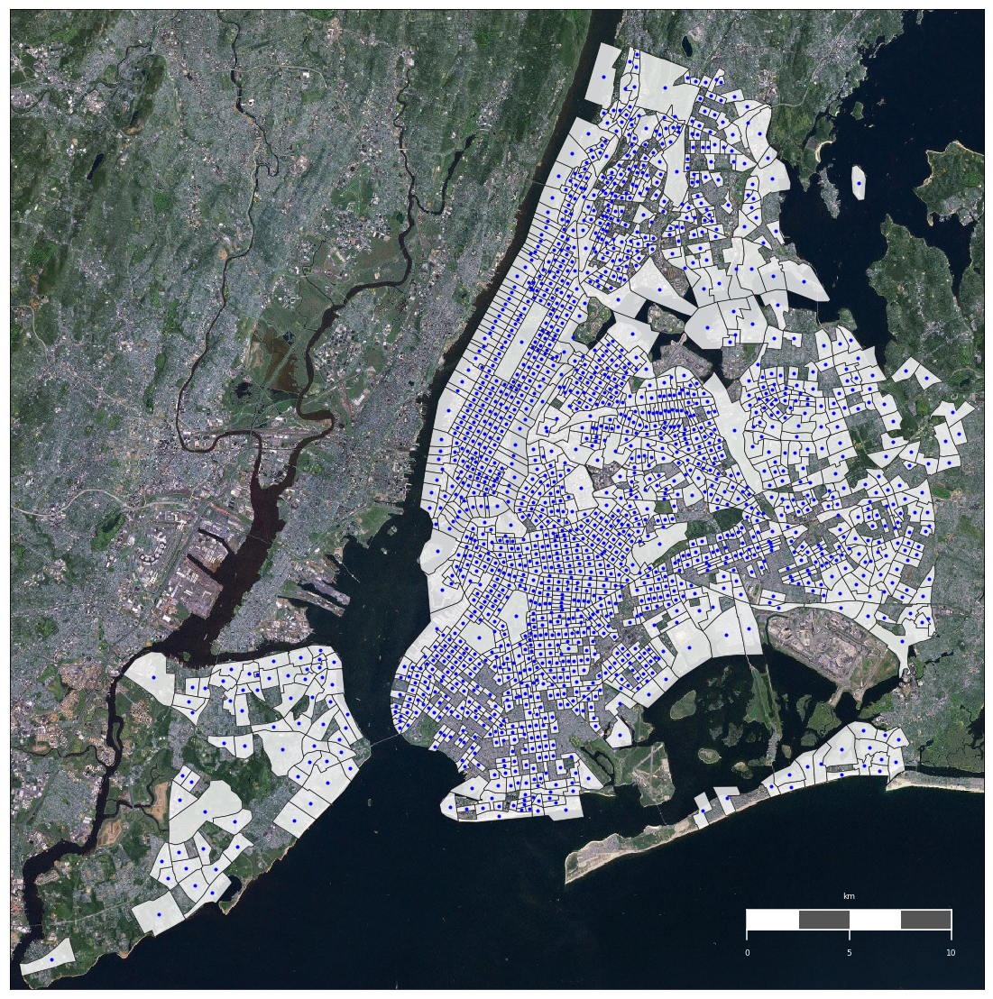

In [25]:
# plt.title('Centroids of New York City Census Tracts', fontsize=tfs)
plotArcGisCentroidMap(poly=map_tracts_poly,
                      centroids=centroids_clean)

**... And display these on the same map as before**

## Neighbors
**Neighbors can be defined in many ways, one of the simplest is to take the** 'K-nearest Neighbors' **of each centroid point**

**This is very easy with pysal and shapefiles!**

In [26]:
knn = ps.knnW_from_shapefile(clean_shp_link, k=4)

# Interested to see the data? Uncomment and run the command below
knn.neighbors

{0: [832, 922, 1221, 36],
 1: [1195, 68, 898, 669],
 2: [408, 553, 1124, 183],
 3: [1338, 968, 628, 469],
 4: [406, 942, 1587, 152],
 5: [58, 1009, 64, 650],
 6: [848, 1586, 894, 252],
 7: [401, 731, 43, 1682],
 8: [845, 328, 997, 125],
 9: [696, 1176, 544, 1584],
 10: [1003, 413, 970, 1100],
 11: [1499, 1648, 683, 1178],
 12: [84, 945, 706, 914],
 13: [1425, 988, 515, 908],
 14: [436, 1006, 380, 603],
 15: [1031, 229, 1401, 653],
 16: [80, 1085, 1546, 1456],
 17: [44, 1581, 1677, 313],
 18: [419, 1360, 1352, 749],
 19: [1087, 347, 587, 189],
 20: [152, 1225, 1430, 1673],
 21: [1619, 192, 617, 818],
 22: [1163, 240, 1489, 1193],
 23: [1562, 1316, 1606, 291],
 24: [452, 822, 220, 746],
 25: [1487, 1111, 1422, 1525],
 26: [45, 499, 633, 108],
 27: [1269, 671, 635, 256],
 28: [519, 1064, 1626, 1574],
 29: [911, 1663, 396, 1091],
 30: [1446, 210, 54, 198],
 31: [970, 90, 241, 867],
 32: [1426, 1269, 1434, 70],
 33: [181, 928, 1528, 1385],
 34: [1602, 1668, 1645, 649],
 35: [865, 385, 469, 

**To test this, we can take a single point, and link this with its neighbors**

In [27]:
self_and_neighbors = [0]
self_and_neighbors.extend(knn.neighbors[0])
print(self_and_neighbors)
map_tracts_info.loc[self_and_neighbors]

[0, 832, 922, 1221, 36]


,RINGNUM,SHAPENUM,age_index,area,asian_frac,asian_popu,assaults_1,assaults_2,assaults_3,avg_age,...,venues_res,venues_s_1,venues_s_2,venues_s_3,venues_sho,venues_t_1,venues_t_2,venues_t_3,venues_tot,venues_tra
0,1,1,0.933534,0.046228,6.28,226.0,2206.470285,102.0,28.36,33.1,...,22,0.204545,0.007217,0.818182,36,0.022727,0.000802,0.409091,176.0,4
832,1,832,0.910916,0.075175,0.69,19.0,2008.655201,151.0,54.91,32.8,...,5,0.333333,0.006014,1.333333,30,0.144444,0.002606,2.600000,90.0,13
922,1,922,0.917273,0.073663,1.07,14.0,2565.722699,189.0,144.83,32.4,...,2,0.132353,0.001804,0.529412,9,0.220588,0.003007,3.970588,68.0,15
1221,1,1221,0.924494,0.082228,38.85,1858.0,498.613409,41.0,8.57,34.9,...,3,0.346154,0.005412,1.384615,27,0.012821,0.000200,0.230769,78.0,1
36,1,37,0.932642,0.071046,1.24,52.0,2012.779367,143.0,34.01,34.6,...,16,0.230088,0.005212,0.920354,26,0.026549,0.000601,0.477876,113.0,3


**Lets use one of the predefined functions to visualise this to check how the linking looks**

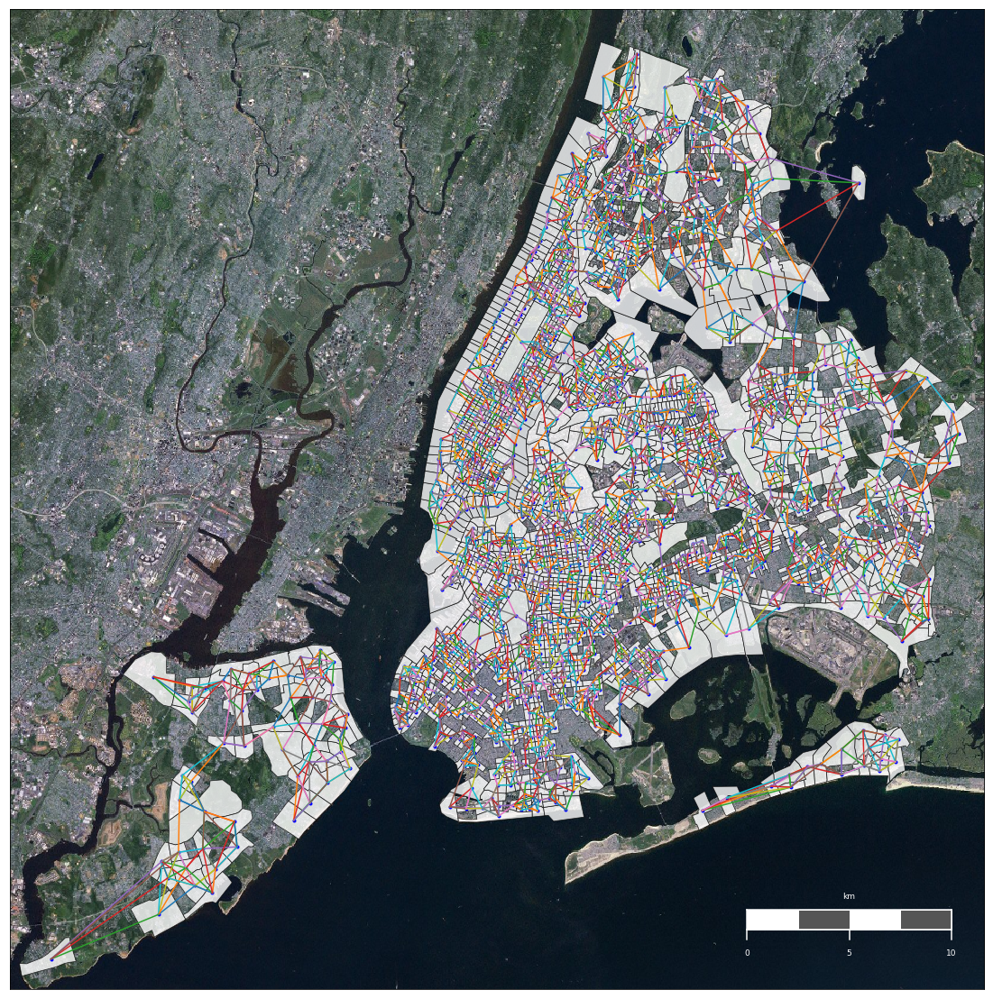

In [28]:
plotArcGisNeighbourMap(poly=map_tracts_poly,
                       centroids=centroids_clean,
                       grouping=knn)

**There are clearly some issues with this approach**

**Other techniques are more suitable when the map data is available**

**Queens Neighbors are those that share an edge OR a corner, and can also be easily generated from shapefiles** 

/Users/bryder/anaconda3/lib/python3.6/site-packages/pysal/weights/weights.py:189: UserWarning: There are 7 disconnected observations
  warnings.warn("There are %d disconnected observations" % ni)
/Users/bryder/anaconda3/lib/python3.6/site-packages/pysal/weights/weights.py:190: UserWarning: Island ids: 245, 418, 429, 745, 813, 1179, 1538
  warnings.warn("Island ids: %s" % ', '.join(str(island) for island in self.islands))


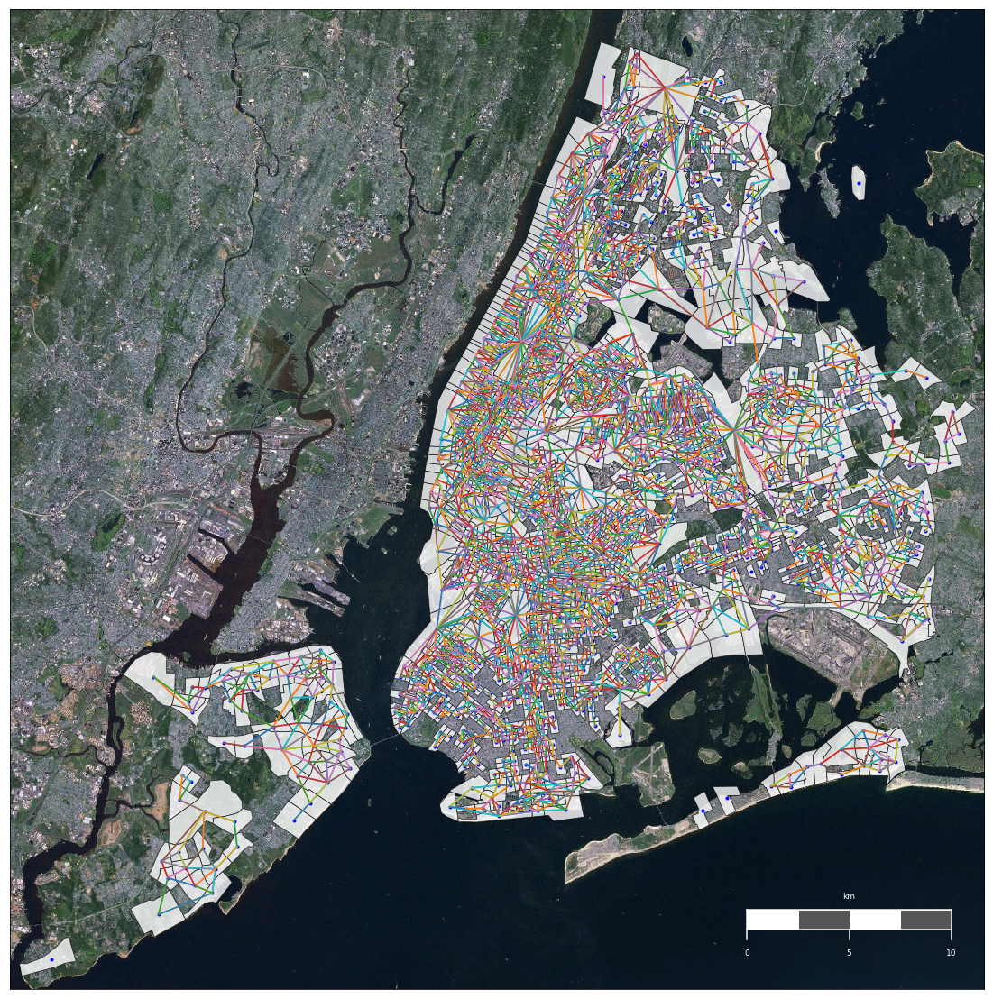

In [29]:
qW = ps.queen_from_shapefile(clean_shp_link)
plotArcGisNeighbourMap(poly=map_tracts_poly,
                       centroids=centroids_clean,
                       grouping=qW)

**This is much better, but perhaps overkill for our problem right now.**

**Especially as US census tracts are often 'grid' based.**

** Rook Neighbors are similar to Queens, but link only via edges (and not corners)**

**.. and can be generated in the same way as before**

/Users/bryder/anaconda3/lib/python3.6/site-packages/pysal/weights/weights.py:189: UserWarning: There are 8 disconnected observations
  warnings.warn("There are %d disconnected observations" % ni)
/Users/bryder/anaconda3/lib/python3.6/site-packages/pysal/weights/weights.py:190: UserWarning: Island ids: 245, 418, 429, 745, 813, 1179, 1366, 1538
  warnings.warn("Island ids: %s" % ', '.join(str(island) for island in self.islands))


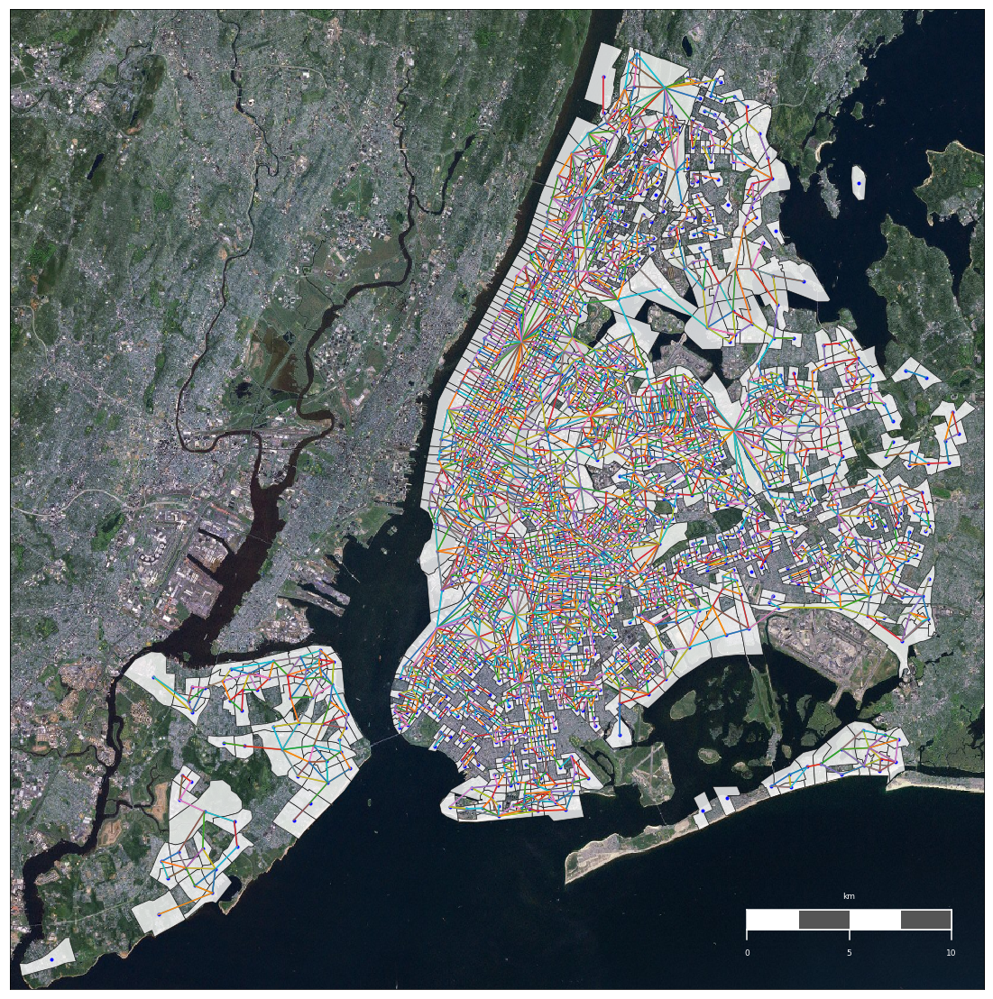

In [30]:
rW = ps.rook_from_shapefile(clean_shp_link)
plotArcGisNeighbourMap(poly=map_tracts_poly,
                       centroids=centroids_clean,
                       grouping=rW)

## Regressions

**We can 'see' some spatial patterns in the data, so let's get down to the regression business** 

** First step: Normalising our dependent variable**

In [31]:
name_y = ['avg_listin']
y = map_tracts_info.loc[:, name_y]
ln_y = np.log(y + 1)
transformed_y = ln_y - mean(ln_y)

# An alternative is to use the BoxCox transformation, uncomment the line below to apply this instead
# transformed_y = analyse_and_transform_wrapper(name_y,y)

**We'll use the Rook Neighbors weighting from before**

**The weights have to be transformed into rows in order to be used...**

**... and then use the pysal spatial lag function with the weights and our dependent variable**

In [32]:
rW.transform = 'r' 
transformed_y_lag = ps.lag_spatial(rW, transformed_y)
transformed_y_lag_values = np.array([tract[0] for tract in transformed_y_lag])

('WARNING: ', 245, ' is an island (no neighbors)')
('WARNING: ', 418, ' is an island (no neighbors)')
('WARNING: ', 429, ' is an island (no neighbors)')
('WARNING: ', 745, ' is an island (no neighbors)')
('WARNING: ', 813, ' is an island (no neighbors)')
('WARNING: ', 1179, ' is an island (no neighbors)')
('WARNING: ', 1366, ' is an island (no neighbors)')
('WARNING: ', 1538, ' is an island (no neighbors)')


**Let's see what these lag values look like!**

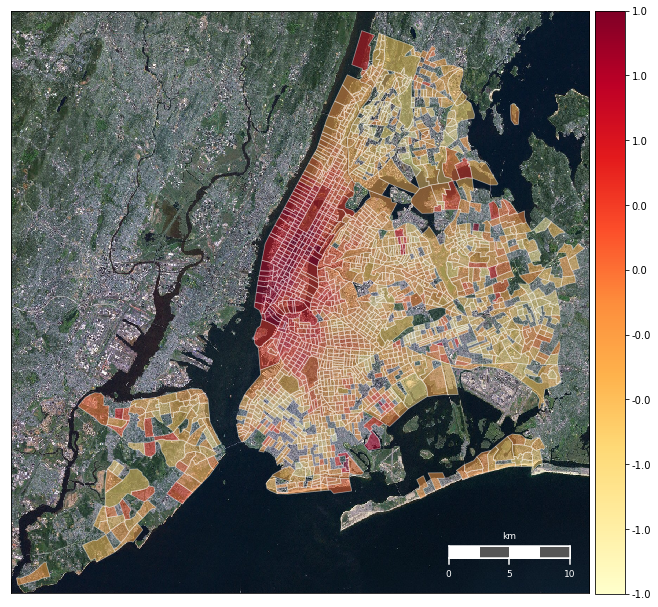

In [33]:
plotArcGisMap(variable=transformed_y_lag_values,
              bin_n=bin_n,
              poly=map_tracts_poly,
              cmap='YlOrRd')

**In PySAL, commonly-used analysis methods are very easy to access. **

**For example, we can quickly compute a Moran's I statistic for price**

In [34]:
MI_transformed_y = ps.Moran(transformed_y, rW)
MI_transformed_y.I, MI_transformed_y.p_sim

(0.53395757360068885, 0.001)

**We can plot this and see the relationship between the price and the surrounding lagged price** 

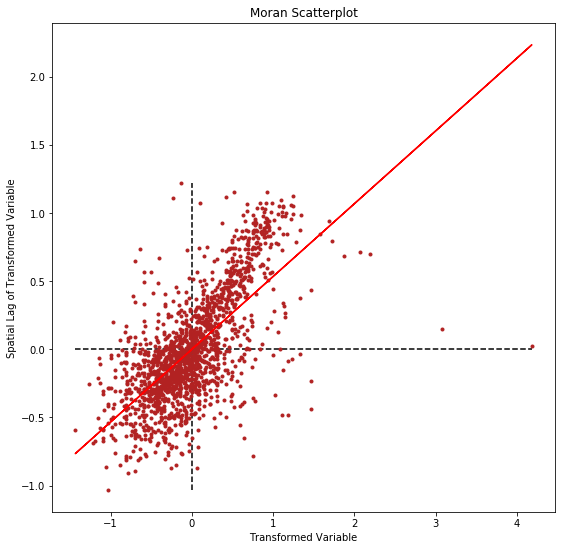

In [35]:
f, ax = plt.subplots(1, figsize=(9, 9))

plt.plot(transformed_y.values, transformed_y_lag, '.', color='firebrick')

plt.vlines(transformed_y.mean(), transformed_y_lag.min(), transformed_y_lag.max(), linestyle='--')
plt.hlines(transformed_y_lag.mean(), transformed_y.min(), transformed_y.max(), linestyle='--')

# red line of best fit using global I as slope
plt.plot(transformed_y.values, MI_transformed_y.I*transformed_y.values, 'r')

plt.title('Moran Scatterplot')
plt.ylabel('Spatial Lag of Transformed Variable')
plt.xlabel('Transformed Variable')
plt.show()


**Lets grab some independent variables...**

-0.284357707637
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[ 2.3733552   1.4038813   1.29145414 ...,  1.56983882  2.33279199
  1.49449388]
[ 1.29347276 -0.15998281 -0.32853596 ...,  0.08882418  1.23265955
 -0.02413453]
X
number of instances:  1684
minimum:  1.0
Q1:  2.0
median:  5.0
mean:  21.5118764846
Q3:  27.0
maximum:  309.0
standard deviation:  35.5828193423
skewness:  3.0458515242725563


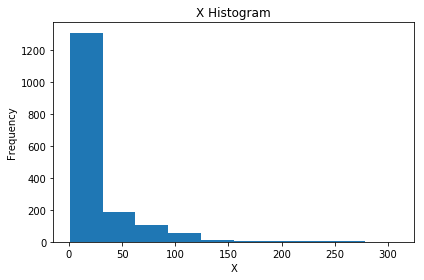

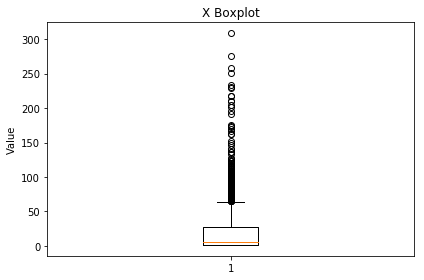

X Standardized
number of instances:  1684
minimum:  -0.576454504272
Q1:  -0.548351053829
median:  -0.464040702501
mean:  -1.16032810175e-17
Q3:  0.15423520724
maximum:  8.0794082321
standard deviation:  1.0
skewness:  3.045851524272557


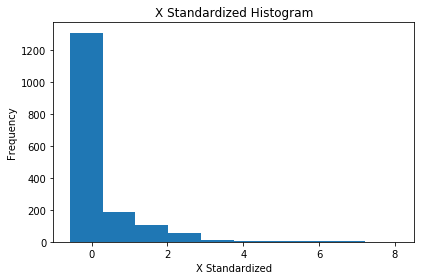

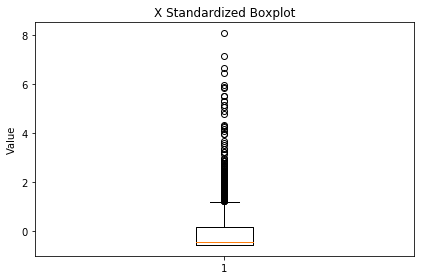

X Transformed
number of instances:  1684
minimum:  0.629112235376
Q1:  0.94356640693
median:  1.40388129907
mean:  1.51059192679
Q3:  2.15329370208
maximum:  2.82852520708
standard deviation:  0.667013098838
skewness:  0.16962462895622163


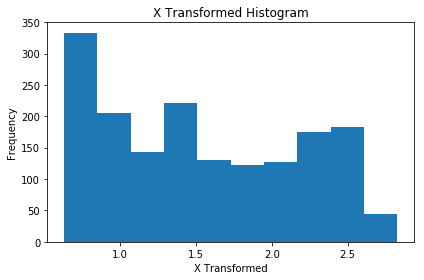

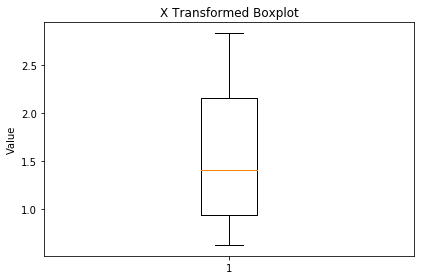

X Transformed Standardized
number of instances:  1684
minimum:  -1.32153280491
Q1:  -0.850096528613
median:  -0.159982806797
mean:  -1.37129684752e-16
Q3:  0.963551954847
maximum:  1.9758731614
standard deviation:  1.0
skewness:  0.16962462895622224


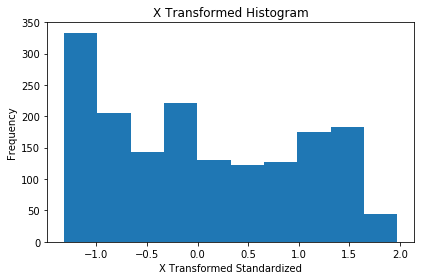

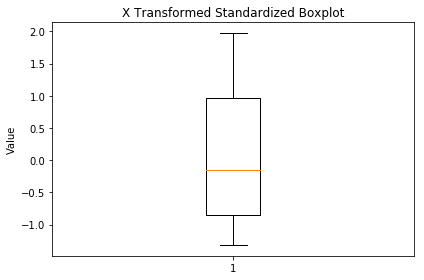

0.435925713051
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[ 55.14803736  36.14386316  57.44373611 ...,  44.44566187  71.81495989
  42.14721964]
[ 0.12264826 -1.02925885  0.2617983  ..., -0.52605882  1.13288665
 -0.66537516]
X
number of instances:  1684
minimum:  0.0
Q1:  967.75
median:  1448.5
mean:  1682.73574822
Q3:  2069.5
maximum:  12651.0
standard deviation:  1164.2028563
skewness:  2.4502600335933225


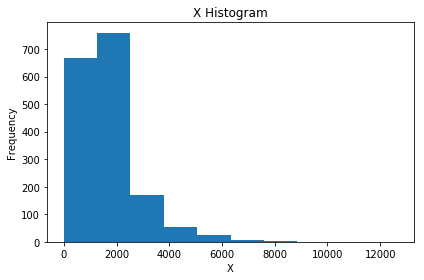

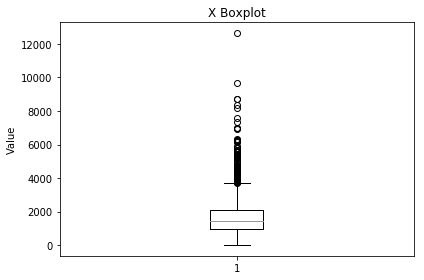

X Standardized
number of instances:  1684
minimum:  -1.44539737135
Q1:  -0.614141894901
median:  -0.201198396783
mean:  2.53162494926e-17
Q3:  0.332213797353
maximum:  9.42126554011
standard deviation:  1.0
skewness:  2.4502600335933225


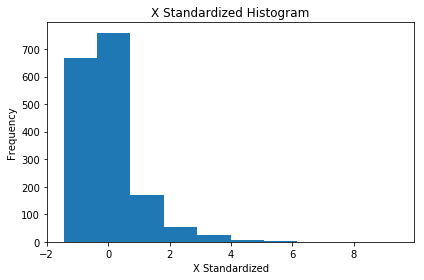

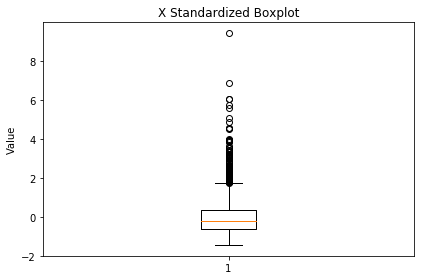

X Transformed
number of instances:  1684
minimum:  0.0
Q1:  43.6632748947
median:  52.4887791805
mean:  53.1245852469
Q3:  61.7016090796
maximum:  138.577868964
standard deviation:  16.4980093823
skewness:  0.2315445429349859


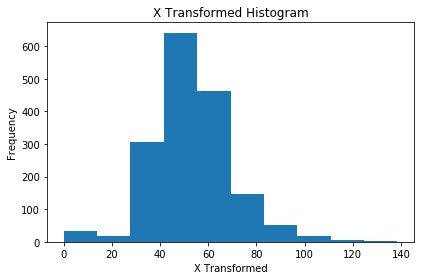

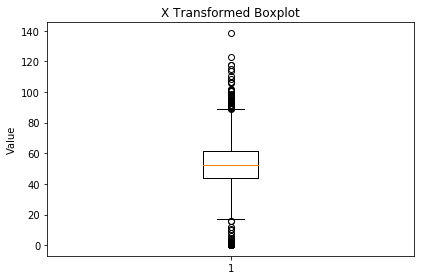

X Transformed Standardized
number of instances:  1684
minimum:  -3.22006031249
Q1:  -0.573481935487
median:  -0.0385383503999
mean:  4.36705303748e-16
Q3:  0.519882346644
maximum:  5.1796117784
standard deviation:  1.0
skewness:  0.23154454293498458


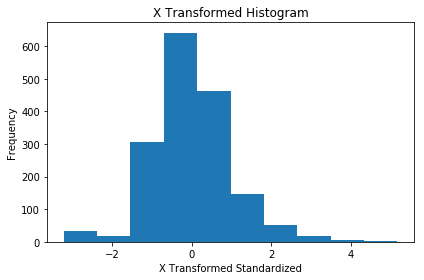

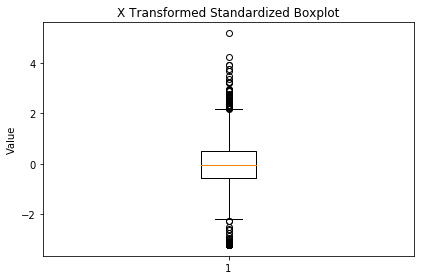

0.215743907901
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[ 11.51860587  10.23356875  13.36954193 ...,  12.39096352  17.91449522
   8.29062317]
[ 0.18451002 -0.16628485  0.68978639 ...,  0.42264991  1.93048698
 -0.69667836]
X
number of instances:  1684
minimum:  0.0
Q1:  139.75
median:  247.0
mean:  407.143111639
Q3:  449.5
maximum:  4597.0
standard deviation:  506.192742875
skewness:  3.17992267247191


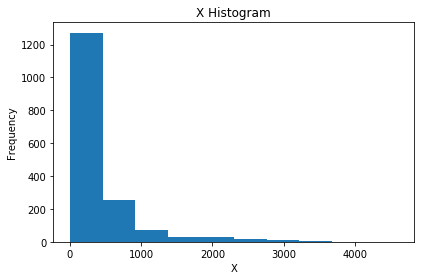

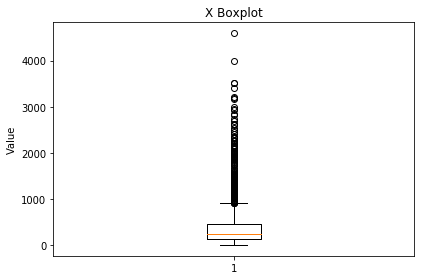

X Standardized
number of instances:  1684
minimum:  -0.804324276414
Q1:  -0.528243668845
median:  -0.316367853734
mean:  2.74259369504e-17
Q3:  0.083677391581
maximum:  8.27719667525
standard deviation:  1.0
skewness:  3.17992267247191


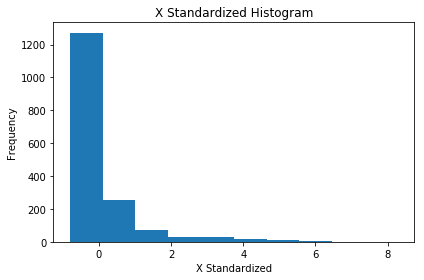

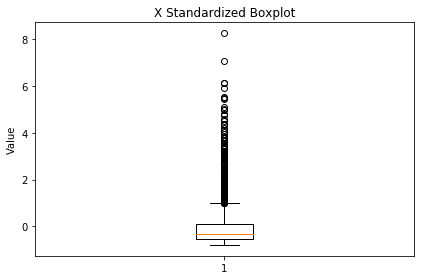

X Transformed
number of instances:  1684
minimum:  0.0
Q1:  8.84133299845
median:  10.5931187356
mean:  10.8427059436
Q3:  12.6861479986
maximum:  23.9564710548
standard deviation:  3.66321521398
skewness:  0.12894228472678415


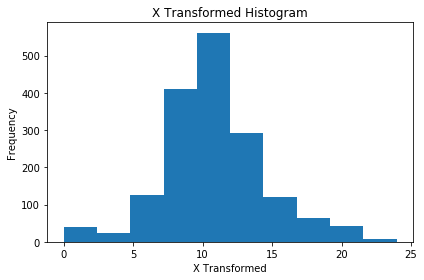

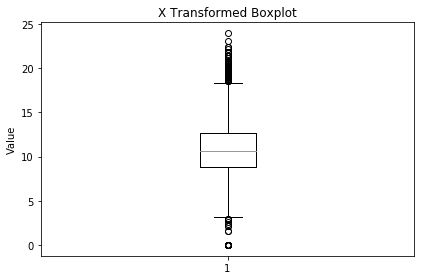

X Transformed Standardized
number of instances:  1684
minimum:  -2.95988777897
Q1:  -0.546343260834
median:  -0.0681333728569
mean:  -1.85652496279e-16
Q3:  0.503230617734
maximum:  3.57985112671
standard deviation:  1.0
skewness:  0.12894228472678448


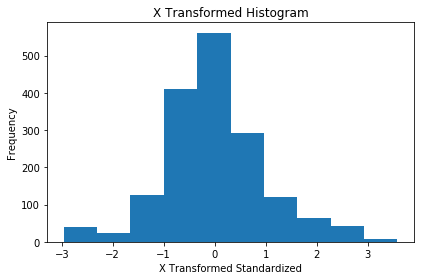

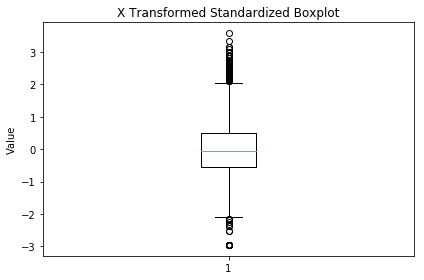

-0.0434776120099
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[ 9.14502988  6.84892308  8.00690871 ...,  9.97898842  9.60457601
  6.47939835]
[ 1.12157786 -0.86702423  0.13587888 ...,  1.84384901  1.51957955
 -1.18706059]
X
number of instances:  1684
minimum:  1.0
Q1:  4879.25
median:  13279.5
mean:  85741.3551069
Q3:  41245.25
maximum:  2569036.0
standard deviation:  234381.56216
skewness:  4.945510947817194


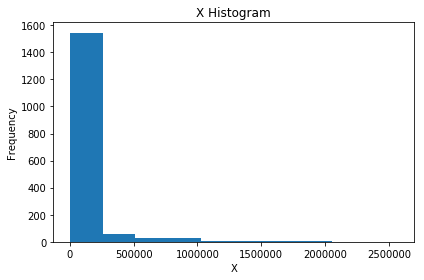

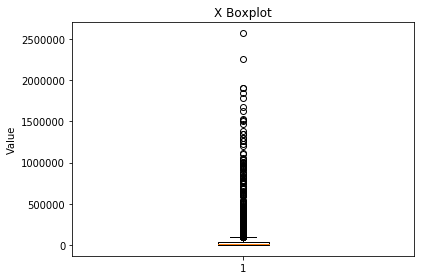

X Standardized
number of instances:  1684
minimum:  -0.365815272826
Q1:  -0.345001988901
median:  -0.309161925704
mean:  -2.53162494926e-17
Q3:  -0.189844733079
maximum:  10.5950938376
standard deviation:  1.0
skewness:  4.945510947817195


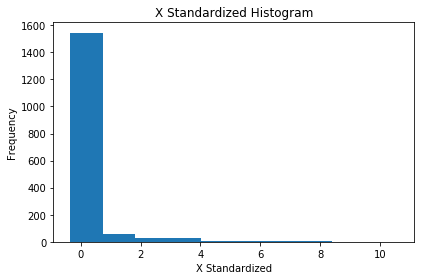

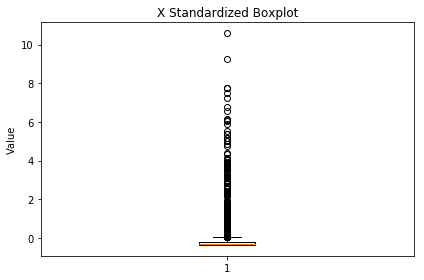

X Transformed
number of instances:  1684
minimum:  0.682806839531
Q1:  7.10134854233
median:  7.778515597
mean:  7.85001839691
Q3:  8.5103409463
maximum:  10.8928897835
standard deviation:  1.1546336046
skewness:  -0.021806738757971882


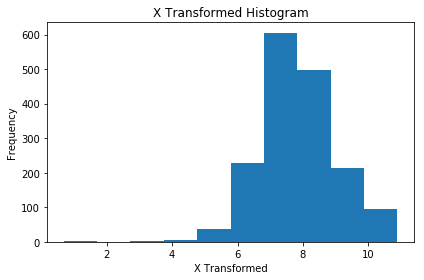

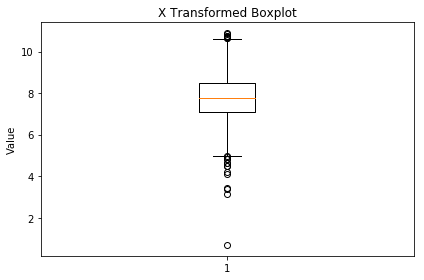

X Transformed Standardized
number of instances:  1684
minimum:  -6.20734710027
Q1:  -0.648404698771
median:  -0.0619268308347
mean:  8.01681233934e-17
Q3:  0.571889252802
maximum:  2.6353566833
standard deviation:  1.0
skewness:  -0.0218067387579719


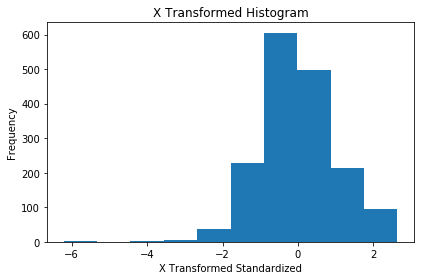

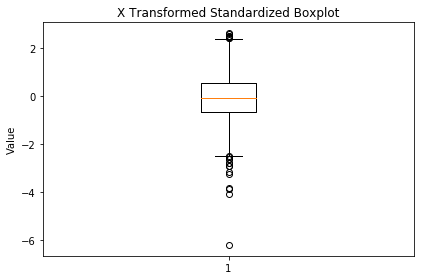

0.112402078934
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[ 10.43138012   7.67408815   8.77772586 ...,  11.96421111  10.14927931
   9.46028705]
[ 0.60184485 -1.27029417 -0.52094908 ...,  1.64260251  0.41030477
 -0.05750543]
X
number of instances:  1684
minimum:  1.0
Q1:  393.0
median:  649.0
mean:  814.311163895
Q3:  1047.25
maximum:  7894.0
standard deviation:  652.618198971
skewness:  3.304995789492345


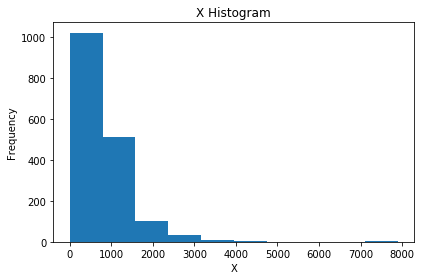

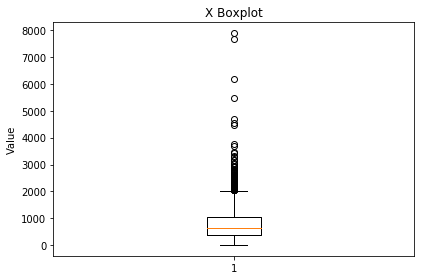

X Standardized
number of instances:  1684
minimum:  -1.24622813948
Q1:  -0.645570663766
median:  -0.253304557176
mean:  -5.48518739007e-17
Q3:  0.356929727782
maximum:  10.8481327172
standard deviation:  1.0
skewness:  3.304995789492344


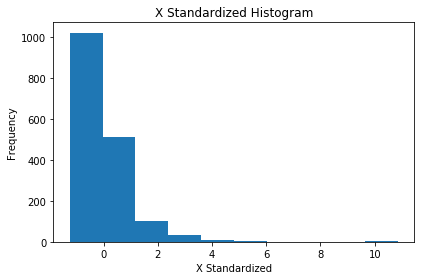

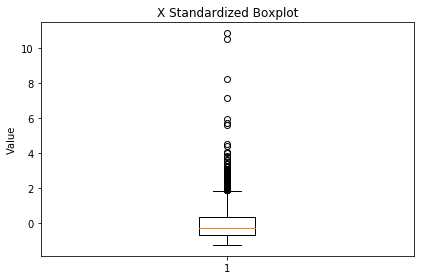

X Transformed
number of instances:  1684
minimum:  0.720864265349
Q1:  8.52002553564
median:  9.52817516249
mean:  9.54498121419
Q3:  10.5449714826
maximum:  15.4981042907
standard deviation:  1.47280299524
skewness:  0.03116252433173487


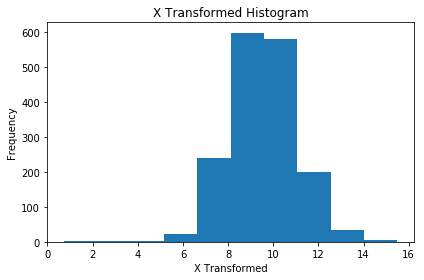

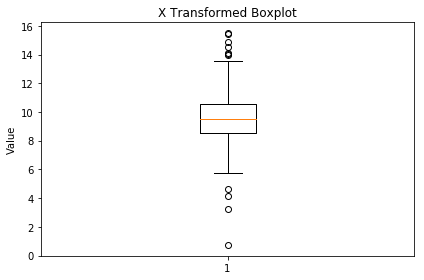

X Transformed Standardized
number of instances:  1684
minimum:  -5.99137629224
Q1:  -0.695921777634
median:  -0.0114109298743
mean:  -5.42189676634e-16
Q3:  0.678970827514
maximum:  4.04203623684
standard deviation:  1.0
skewness:  0.03116252433173627


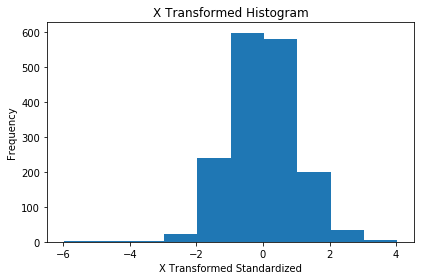

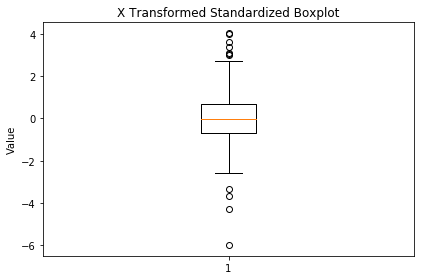

4.07962395309
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[ 180319.02150619  151479.02220227  266224.49326439 ...,  174250.28123532
  263619.6588625   169750.25726866]
[ 0.41864781 -0.20022353  2.26207484 ...,  0.28842002  2.20617826
  0.19185498]
X
number of instances:  1684
minimum:  0.0
Q1:  24.352018484
median:  25.7374265319
mean:  25.3223158888
Q3:  26.8272309531
maximum:  29.9473412
standard deviation:  2.82261233334
skewness:  -4.679678763281224


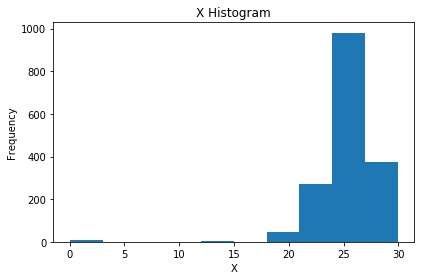

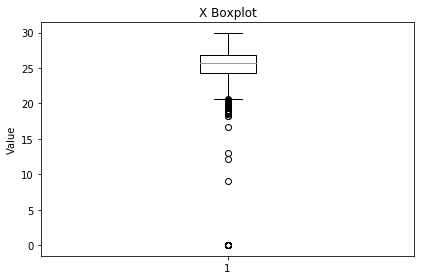

X Standardized
number of instances:  1684
minimum:  -8.97123405493
Q1:  -0.343758649848
median:  0.147066119645
mean:  2.39449526451e-16
Q3:  0.53316392286
maximum:  1.63856200038
standard deviation:  1.0
skewness:  -4.679678763281224


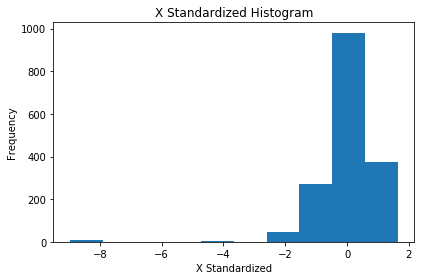

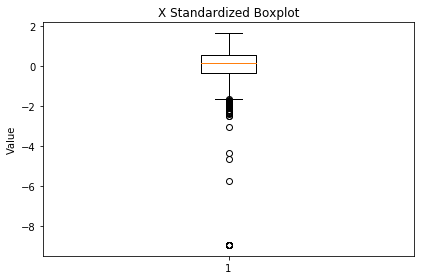

X Transformed
number of instances:  1684
minimum:  0.0
Q1:  130985.208403
median:  162738.604022
mean:  160809.630964
Q3:  191546.267778
maximum:  295503.209615
standard deviation:  46600.961309
skewness:  -0.27941400114809


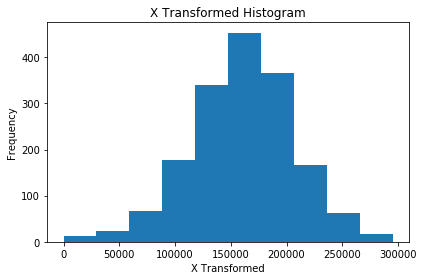

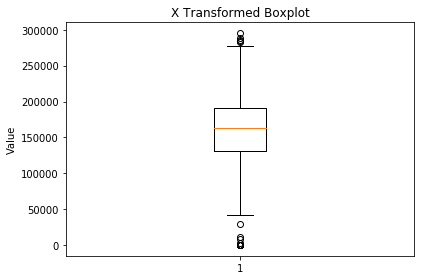

X Transformed Standardized
number of instances:  1684
minimum:  -3.45077926392
Q1:  -0.639995865382
median:  0.0413934177436
mean:  -4.64131240698e-17
Q3:  0.659570874753
maximum:  2.89036051765
standard deviation:  1.0
skewness:  -0.27941400114808984


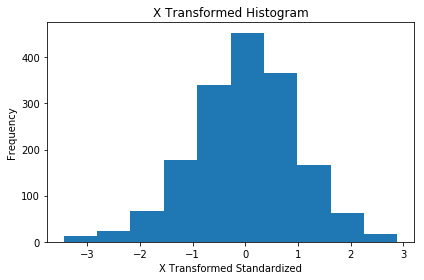

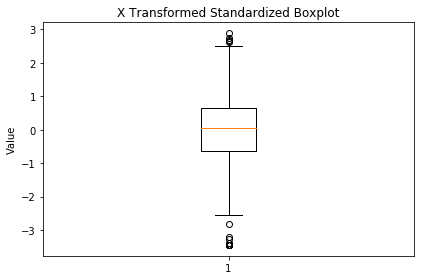

In [36]:
name_x=['count_list','total_hous','high_incom','checkins_t','incidents_','avg_qscore']
#name_x=['population','total_hous','larcenie_1','robberie_1','burglari_1','assaults_1','murders__1',]
x = map_tracts_info.loc[:, name_x]
transformed_x = analyse_and_transform_wrapper(name_x,x)

**To run the model, we can use the spreg module in PySAL, which implements a standard OLS routine, but is particularly well suited for regressions on spatial data. Also, although for the initial model we do not need it, let us build a spatial weights matrix that connects every observation to its 8 nearest neighbors. This will allow us to get extra diagnostics from the baseline model.**

In [37]:
model_ols = ps.spreg.OLS(y=transformed_y.values, \
                         x=transformed_x.values, \
                         w=rW, \
                         name_y='transformed_average_price', \
                         name_x=name_x, \
                         spat_diag=True)
print(model_ols.summary)

REGRESSION
----------
SUMMARY OF OUTPUT: ORDINARY LEAST SQUARES
-----------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :transformed_average_price                Number of Observations:        1684
Mean dependent var  :      0.0000                Number of Variables   :           7
S.D. dependent var  :      0.5153                Degrees of Freedom    :        1677
R-squared           :      0.3254
Adjusted R-squared  :      0.3230
Sum squared residual:     301.515                F-statistic           :    134.8293
Sigma-square        :       0.180                Prob(F-statistic)     :  1.665e-139
S.E. of regression  :       0.424                Log likelihood        :    -941.162
Sigma-square ML     :       0.179                Akaike info criterion :    1896.324
S.E of regression ML:      0.4231                Schwarz criterion     :    1934.327

----------------------------------------------------------------

**If we include the lagged prices of the neighbors in the model, we violate some of the assumptions on which OLS relies. **

**We can use GM_lag to account for this and include the spatially lagged varible**

In [38]:
model_lag = ps.spreg.GM_Lag(y=transformed_y.values, \
                            x=transformed_x.values, \
                            w=rW, \
                            name_y='transformed_average_price', \
                            name_x=name_x)
print(model_lag.summary)

REGRESSION
----------
SUMMARY OF OUTPUT: SPATIAL TWO STAGE LEAST SQUARES
--------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :transformed_average_price                Number of Observations:        1684
Mean dependent var  :      0.0000                Number of Variables   :           8
S.D. dependent var  :      0.5153                Degrees of Freedom    :        1676
Pseudo R-squared    :      0.4711
Spatial Pseudo R-squared:  0.3812

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTANT      -0.0021745       0.0091755      -0.2369837       0.8126694
          count_list       0.0126343       0.0139389       0.9064064       0.3647208
          total_hous      -0.0289939       0.0

**There are several over spatial regression methods built into PySAL**

**Spatial Error is when the error values in the models are spatially lagged**

In [39]:
model_error = ps.spreg.GM_Error(y=transformed_y.values, \
                                x=transformed_x.values, \
                                w=rW, \
                                name_y='transformed_average_price', \
                                name_x=name_x)
print(model_error.summary)

REGRESSION
----------
SUMMARY OF OUTPUT: SPATIALLY WEIGHTED LEAST SQUARES
---------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :transformed_average_price                Number of Observations:        1684
Mean dependent var  :      0.0000                Number of Variables   :           7
S.D. dependent var  :      0.5153                Degrees of Freedom    :        1677
Pseudo R-squared    :      0.3219

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTANT       0.0041490       0.0152588       0.2719070       0.7856935
          count_list       0.1001122       0.0161790       6.1877747       0.0000000
          total_hous      -0.0789610       0.0187094      -4.2203970       0.0

**Spatial Combo is when both the dependent variable and the error values in the models are spatially lagged**

In [40]:
model_combo = ps.spreg.GM_Combo(y=transformed_y.values, \
                                x=transformed_x.values, \
                                w=rW, \
                                name_y='transformed_average_price', \
                                name_x=name_x)
print(model_combo.summary)

REGRESSION
----------
SUMMARY OF OUTPUT: SPATIALLY WEIGHTED TWO STAGE LEAST SQUARES
-------------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :transformed_average_price                Number of Observations:        1684
Mean dependent var  :      0.0000                Number of Variables   :           8
S.D. dependent var  :      0.5153                Degrees of Freedom    :        1676
Pseudo R-squared    :      0.4666
Spatial Pseudo R-squared:  0.3874

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTANT      -0.0006999       0.0041624      -0.1681486       0.8664663
          count_list       0.0041676       0.0087430       0.4766815       0.6335889
          total_hous    

**Interested in trying out some other regressions? Here's a list of the variables in the dataset**
*Refer to the powerpoint for a complete list of the full names*.

In [41]:
# Interested to see the data? Uncomment and run the command below
dataset.columns.tolist()


['geom_id',
 'id',
 'county',
 'tract',
 'geom_gps',
 'locations_',
 'incidents_',
 'incident_1',
 'larcenies_',
 'robberies_',
 'burglaries',
 'assaults_2',
 'vehicles_2',
 'murders_20',
 'rapes_2011',
 'incident_2',
 'incident_3',
 'larcenie_1',
 'robberie_1',
 'burglari_1',
 'assaults_1',
 'vehicles_1',
 'murders__1',
 'rapes_20_1',
 'incident_4',
 'incident_5',
 'larcenie_2',
 'robberie_2',
 'burglari_2',
 'assaults_3',
 'vehicles_3',
 'murders__2',
 'rapes_20_2',
 'area',
 'logrecno',
 'population',
 'total_popu',
 'male_popul',
 'male_fract',
 'male_15_34',
 'male_15__1',
 'avg_age',
 'male_avg_a',
 'female_avg',
 'i_mb17',
 'i_m18_34',
 'i_m35_64',
 'i_mo65',
 'i_fb17',
 'i_f18_34',
 'i_f35_64',
 'i_fo65',
 'age_index',
 'black_popu',
 'black_frac',
 'asian_popu',
 'asian_frac',
 'hispanic_p',
 'hispanic_f',
 'i_white',
 'i_black',
 'i_asian',
 'i_other',
 'i_hispanic',
 'racial_eth',
 'total_hous',
 'housing_de',
 'vacant_hou',
 'vacant_fra',
 'rented_hou',
 'rented_fra',
 'avg

## Adding the listing attributes and running the analysis on point level

**We need to import the data from the other shape file**

In [42]:
airbnb_shp_link = "./Data/export.shp"
airbnb_tx = ps.pdio.read_files(airbnb_shp_link)
#print(type(airbnb_tx))
airbnb_tx.head()

,listing_id,gps_coord,latitude,longitude,room_type,accomodate,bathrooms,bedrooms,beds,bed_type,...,mta_we_wee,mta_we_w_1,mta_week_w,mta_week_1,mta_we_mor,mta_week_m,max_qscore,min_qscore,avg_qscore,geometry
0,10267,SRID=4326;POINT(-73.9631246 40.67543027),40.675430,-73.963125,0,1,1.0,1.0,1.0,Real Bed,...,NaN,NaN,NaN,NaN,,,37.892654,18.491983,26.732454,"(994478.6093965571, 185356.02239743754)"
1,25095,SRID=4326;POINT(-73.95799829 40.74576918),40.745769,-73.957998,1,4,1.0,0.0,2.0,Real Bed,...,2055.754902,1897.343137,2.814611e+04,3.403660e+04,t,f,32.999825,-4.000000,18.710652,"(995888.2729739572, 210983.2532779986)"
2,36882,SRID=4326;POINT(-73.998693 40.73792111),40.737921,-73.998693,1,2,1.0,0.0,1.0,Real Bed,...,3624.872549,8209.343137,1.168052e+07,1.192429e+07,f,f,41.670647,15.671375,27.412698,"(984612.1999021632, 208121.1643725)"
3,0,SRID=4326;POINT(-73.78867963 40.85205378),40.852054,-73.788680,0,2,1.0,1.0,1.0,Real Bed,...,NaN,NaN,NaN,NaN,,,NaN,NaN,NaN,"(1042711.3870158461, 249774.17458121327)"
4,3,SRID=4326;POINT(-73.78660939 40.84977457),40.849775,-73.786609,1,3,1.0,1.0,1.0,Real Bed,...,NaN,NaN,NaN,NaN,,,NaN,NaN,NaN,"(1043286.1368261221, 248945.16253132556)"


***Let's check the name and unit of the projection***

In [43]:
driver = ogr.GetDriverByName('ESRI Shapefile')
shape = driver.Open('./Data/export.shp')
layer= shape.GetLayer()
spatial_ref = layer.GetSpatialRef()
print(spatial_ref)
# using local NY Long Island projection in US feet

PROJCS["NAD83_New_York_Long_Island_ftUS",
    GEOGCS["GCS_North_American_1983",
        DATUM["North_American_Datum_1983",
            SPHEROID["GRS_1980",6378137,298.257222101]],
        PRIMEM["Greenwich",0],
        UNIT["Degree",0.017453292519943295],
        AUTHORITY["EPSG","4269"]],
    PROJECTION["Lambert_Conformal_Conic_2SP"],
    PARAMETER["standard_parallel_1",41.03333333333333],
    PARAMETER["standard_parallel_2",40.66666666666666],
    PARAMETER["latitude_of_origin",40.16666666666666],
    PARAMETER["central_meridian",-74],
    PARAMETER["false_easting",984250.0000000002],
    PARAMETER["false_northing",0],
    UNIT["Foot_US",0.30480060960121924]]


In [44]:
data = airbnb_tx.fillna(0)
data.info() 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31454 entries, 0 to 31453
Columns: 206 entries, listing_id to geometry
dtypes: float64(147), int64(4), object(55)
memory usage: 49.4+ MB


In [45]:
# Interested to see the data? 
data.columns.tolist()

['listing_id',
 'gps_coord',
 'latitude',
 'longitude',
 'room_type',
 'accomodate',
 'bathrooms',
 'bedrooms',
 'beds',
 'bed_type',
 'square_fee',
 'number_of_',
 'review_sco',
 'review_s_1',
 'review_s_2',
 'review_s_3',
 'review_s_4',
 'reviews_pe',
 'price',
 'weekly_pri',
 'monthly_pr',
 'geom_id',
 'id',
 'county',
 'tract',
 'geom_gps',
 'geom_ftus',
 'locations_',
 'incidents_',
 'incident_1',
 'larcenies_',
 'robberies_',
 'burglaries',
 'assaults_2',
 'vehicles_2',
 'murders_20',
 'rapes_2011',
 'incident_2',
 'incident_3',
 'larcenie_1',
 'robberie_1',
 'burglari_1',
 'assaults_1',
 'vehicles_1',
 'murders__1',
 'rapes_20_1',
 'incident_4',
 'incident_5',
 'larcenie_2',
 'robberie_2',
 'burglari_2',
 'assaults_3',
 'vehicles_3',
 'murders__2',
 'rapes_20_2',
 'area',
 'logrecno',
 'population',
 'total_popu',
 'male_popul',
 'male_fract',
 'male_15_34',
 'male_15__1',
 'avg_age',
 'male_avg_a',
 'female_avg',
 'i_mb17',
 'i_m18_34',
 'i_m35_64',
 'i_mo65',
 'i_fb17',
 'i_f1

**Prepare the dependent variable**

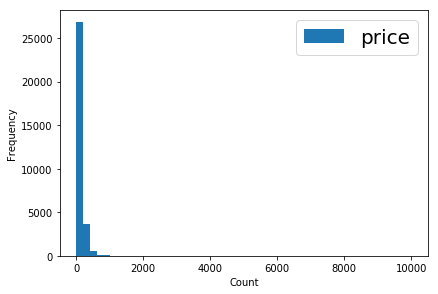

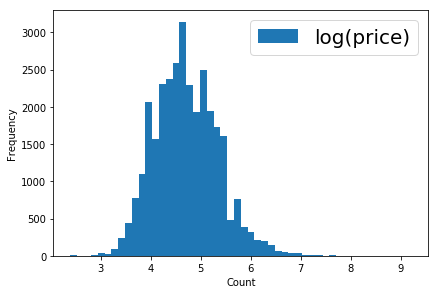

In [46]:
ybins = 50
plt.hist(data['price'].values, bins=ybins, label='price')
plt.rc('legend', fontsize=20) 
plt.tight_layout()
plt.xlabel('Count')
plt.ylabel('Frequency')
plt.legend(loc='upper right')
plt.show()
plt.clf()

data['price_log'] = data['price'].apply(helpers.smooth_log)
#data['price_log'] = np.log(data['price'] + 1.0)

ybins = 50
plt.hist(data['price_log'].values, bins=ybins, label='log(price)')
plt.rc('legend', fontsize=20) 
plt.tight_layout()
plt.xlabel('Count')
plt.ylabel('Frequency')
plt.legend(loc='upper right')
plt.show()
plt.clf()

**Prepare the independent variables**

In [47]:
set(data.bed_type)

{'Airbed', 'Couch', 'Futon', 'Pull-out Sofa', 'Real Bed'}

In [48]:
# lets simplify things
def has_realbed(a):
    if (a=='Real Bed'):
        return 1
    else:
        return 0
data['bedroom_type'] = data['bed_type'].apply(has_realbed)


0.339256120889
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[  4.16384513   4.03567038   3.17374791 ...,   7.29071812   0.          11.15989213]
[-0.41517493 -0.49638915 -1.04252142 ...,  1.5660778  -3.05347508
  4.01766812]
X
number of instances:  31454
minimum:  0.0
Q1:  9.7625
median:  16.02
mean:  18.443950213
Q3:  25.64
maximum:  100.0
standard deviation:  10.9578007653
skewness:  0.785790104452521


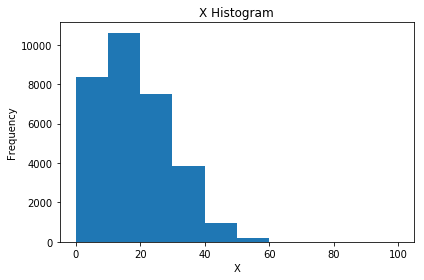

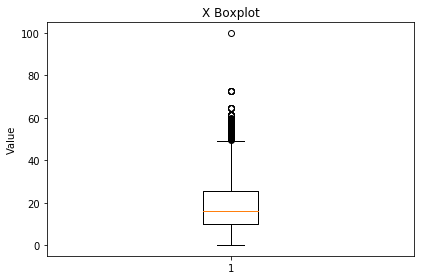

X Standardized
number of instances:  31454
minimum:  -1.68317991977
Q1:  -0.792262097017
median:  -0.221207728168
mean:  -1.59032900736e-16
Q3:  0.656705660298
maximum:  7.44273887925
standard deviation:  1.0
skewness:  0.7857901044525211


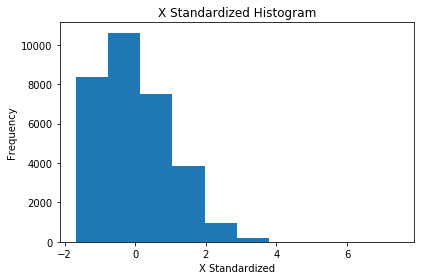

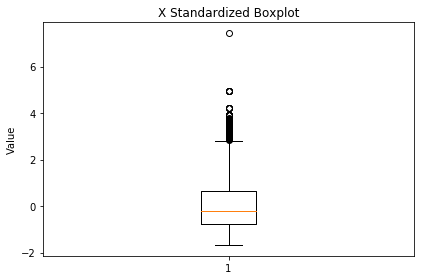

X Transformed
number of instances:  31454
minimum:  0.0
Q1:  3.65254215079
median:  4.76288034471
mean:  4.8190867528
Q3:  6.02859509114
maximum:  11.1598921296
standard deviation:  1.57823025334
skewness:  -0.03351536520082319


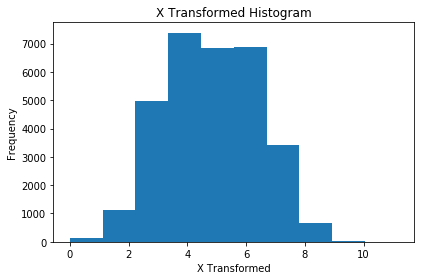

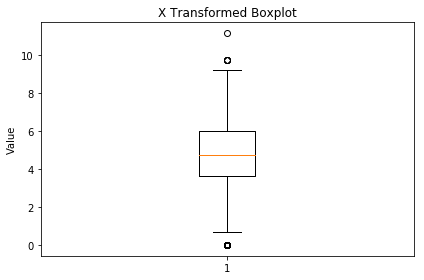

X Transformed Standardized
number of instances:  31454
minimum:  -3.05347508236
Q1:  -0.739147281924
median:  -0.0356135665116
mean:  4.33726092916e-16
Q3:  0.766370012093
maximum:  4.01766812124
standard deviation:  1.0
skewness:  -0.03351536520082441


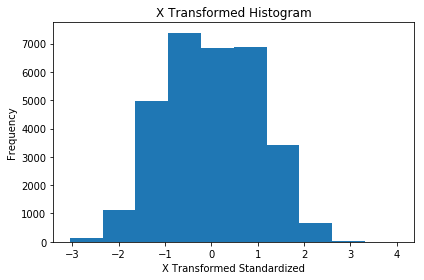

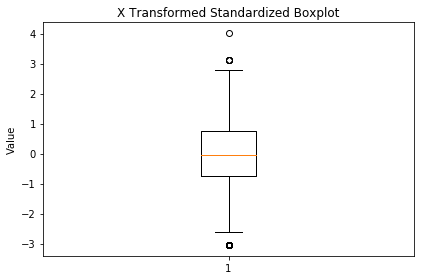

-0.177076866393
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[ 2.79133003  1.77480625  0.94418184 ...,  2.36304264  0.          3.00554497]
[ 1.14422814 -0.13504422 -1.1803664  ...,  0.60523807 -2.36859807
  1.41381283]
X
number of instances:  31454
minimum:  0.0
Q1:  2.92
median:  7.44
mean:  22.5675303618
Q3:  36.63
maximum:  96.55
standard deviation:  27.6139921891
skewness:  1.219727669709544


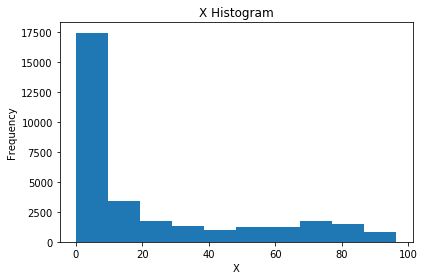

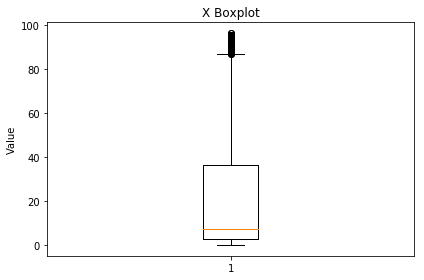

X Standardized
number of instances:  31454
minimum:  -0.817249827814
Q1:  -0.711506334443
median:  -0.547821200868
mean:  7.22876821527e-17
Q3:  0.509251597592
maximum:  2.67916602321
standard deviation:  1.0
skewness:  1.219727669709544


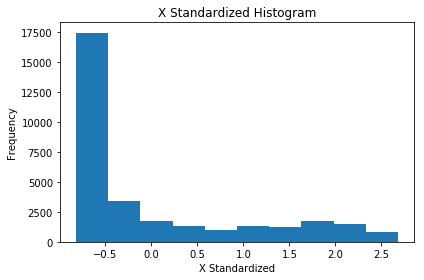

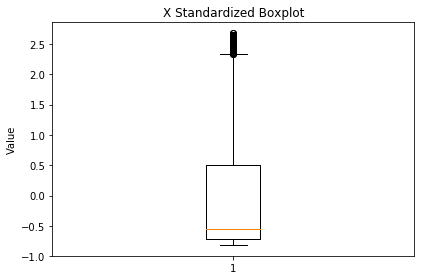

X Transformed
number of instances:  31454
minimum:  0.0
Q1:  1.21341569163
median:  1.77643277461
mean:  1.88211386561
Q3:  2.67664225878
maximum:  3.1377370907
standard deviation:  0.794610909655
skewness:  0.09632940778090643


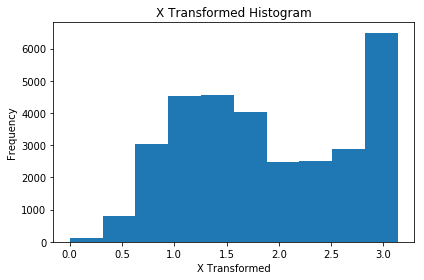

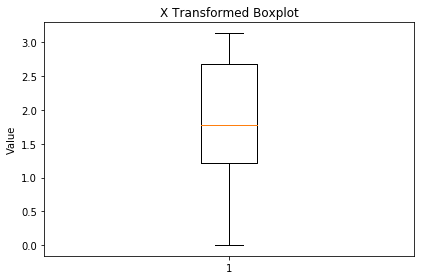

X Transformed Standardized
number of instances:  31454
minimum:  -2.36859806824
Q1:  -0.84154164744
median:  -0.132997281709
mean:  3.18065801472e-16
Q3:  0.999896154852
maximum:  1.58017365459
standard deviation:  1.0
skewness:  0.09632940778090562


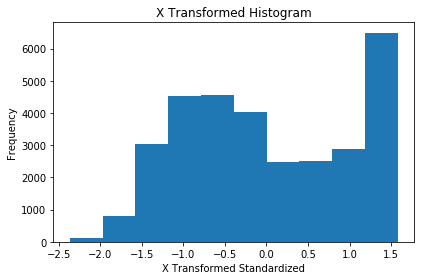

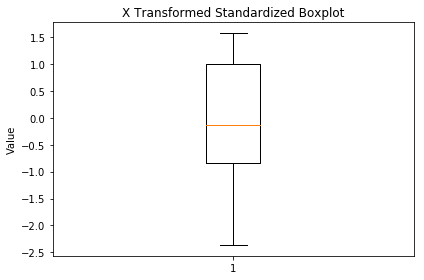

-0.0663588008124
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[ 2.23902081  2.20118652  1.79089654 ...,  3.47168544  0.          2.89832255]
[-0.63038726 -0.6891548  -1.32645307 ...,  1.28429525 -4.10823021
  0.39369785]
X
number of instances:  31454
minimum:  0.0
Q1:  9.04
median:  16.74
mean:  24.3806224963
Q3:  33.09
maximum:  100.0
standard deviation:  20.7505196346
skewness:  1.2930032402372271


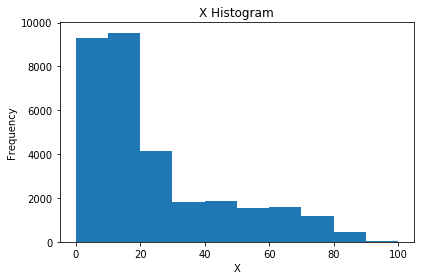

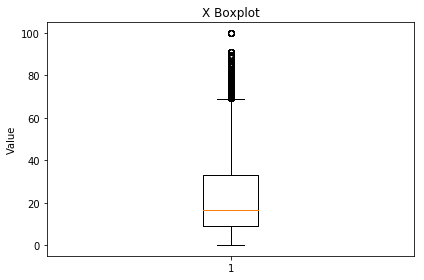

X Standardized
number of instances:  31454
minimum:  -1.17494033526
Q1:  -0.739288594527
median:  -0.368213549872
mean:  -2.38549351104e-16
Q3:  0.419718525465
maximum:  3.64421608882
standard deviation:  1.0
skewness:  1.2930032402372276


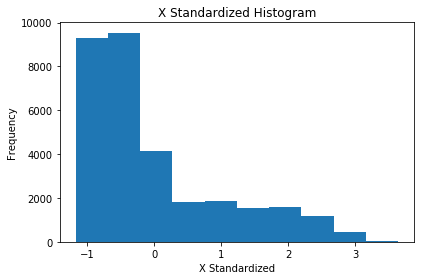

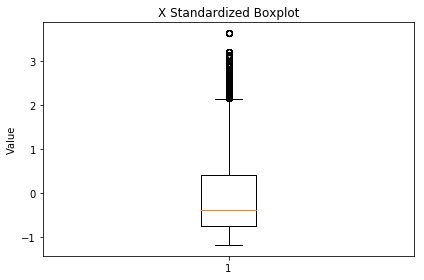

X Transformed
number of instances:  31454
minimum:  0.0
Q1:  2.13872484045
median:  2.61807015231
mean:  2.64486150539
Q3:  3.1462442513
maximum:  3.9753626494
standard deviation:  0.64379583621
skewness:  0.006319670918953505


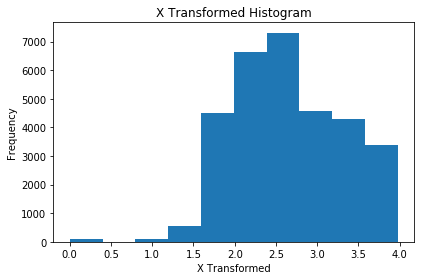

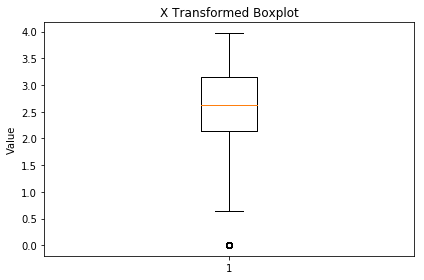

X Transformed Standardized
number of instances:  31454
minimum:  -4.1082302131
Q1:  -0.786175735337
median:  -0.041614672812
mean:  5.8191584133e-16
Q3:  0.778791532519
maximum:  2.0666507442
standard deviation:  1.0
skewness:  0.006319670918951639


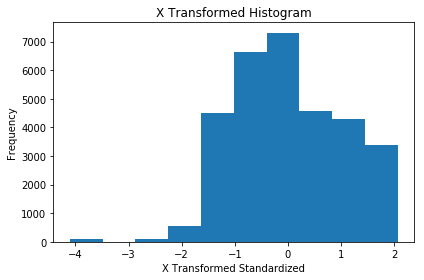

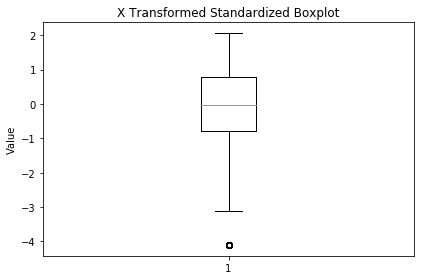

0.294661625058
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[  7.89067884   6.51865859  10.34305842 ...,   9.3858601    0.          10.5504684 ]
[-0.25283938 -0.77822467  0.686246   ...,  0.31970774 -3.27440309
  0.76566914]
X
number of instances:  31454
minimum:  0.0
Q1:  36.0
median:  72.0
mean:  84.46909773
Q3:  119.0
maximum:  466.0
standard deviation:  58.4684941464
skewness:  1.0387969597798052


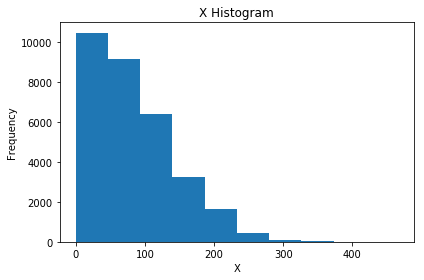

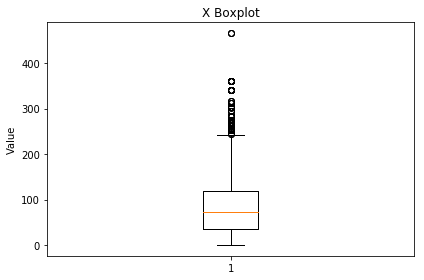

X Standardized
number of instances:  31454
minimum:  -1.44469425736
Q1:  -0.828978040868
median:  -0.213261824373
mean:  1.44575364305e-16
Q3:  0.590589902718
maximum:  6.5254101006
standard deviation:  1.0
skewness:  1.0387969597798048


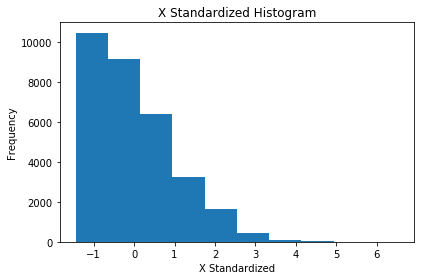

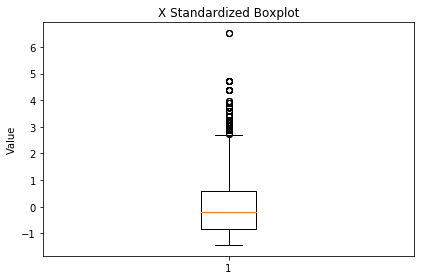

X Transformed
number of instances:  31454
minimum:  0.0
Q1:  6.44107125618
median:  8.62134281937
mean:  8.55095759344
Q3:  10.5164117827
maximum:  17.3660053123
standard deviation:  2.61145538661
skewness:  -0.04139317472700714


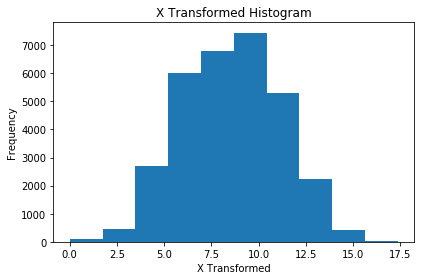

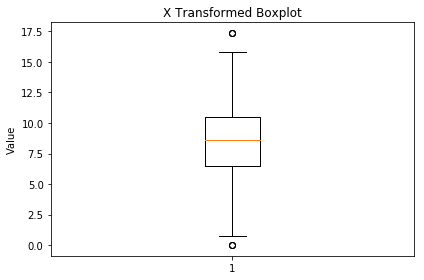

X Transformed Standardized
number of instances:  31454
minimum:  -3.27440309234
Q1:  -0.807935049579
median:  0.0269524902823
mean:  1.44575364305e-17
Q3:  0.752627902166
maximum:  3.37553065776
standard deviation:  1.0
skewness:  -0.041393174727007195


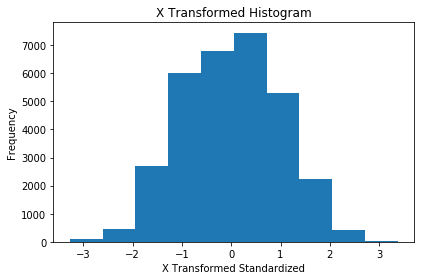

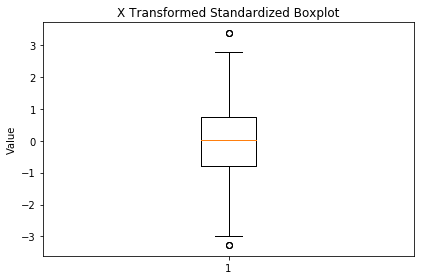

2.74814219537
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[ 57576.32514716  64044.67773073  37629.03769549 ...,  96897.32468656
      0.              0.        ]
[-0.31271664 -0.06828491 -1.06650209 ...,  1.17317948 -2.48846089
 -2.48846089]
X
number of instances:  31454
minimum:  0.0
Q1:  71.65
median:  81.58
mean:  78.7416497107
Q3:  89.28
maximum:  100.0
standard deviation:  14.6113887199
skewness:  -1.3796780055995295


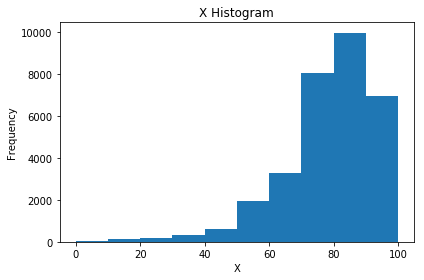

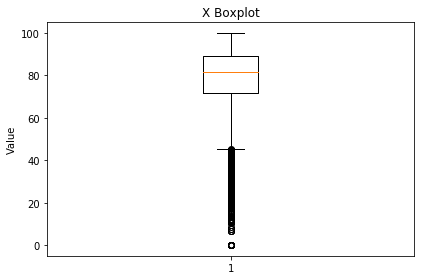

X Standardized
number of instances:  31454
minimum:  -5.38905994634
Q1:  -0.485350834657
median:  0.194256024785
mean:  -6.50589139375e-16
Q3:  0.72124220985
maximum:  1.45491648308
standard deviation:  1.0
skewness:  -1.3796780055995272


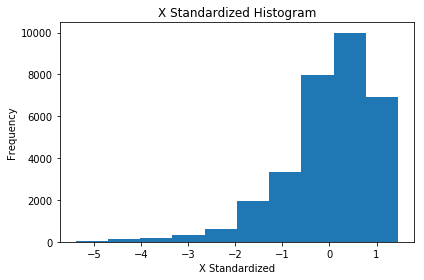

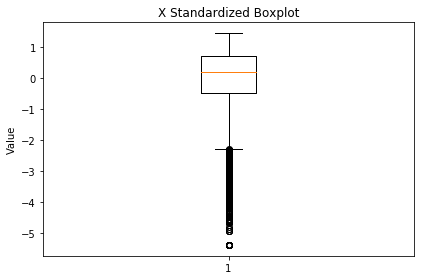

X Transformed
number of instances:  31454
minimum:  0.0
Q1:  47413.0185567
median:  67422.242401
mean:  65851.6889015
Q3:  86139.5545505
maximum:  117251.819881
standard deviation:  26462.818563
skewness:  -0.22997468979088137


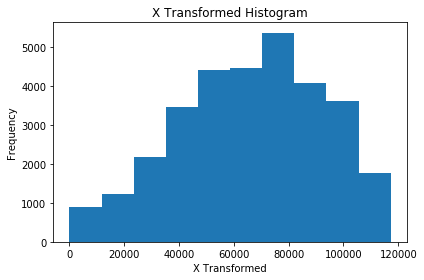

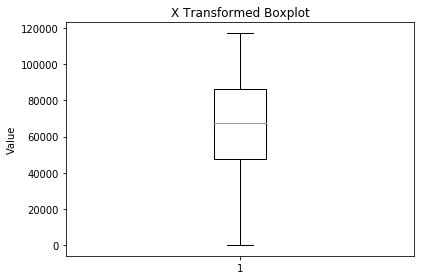

X Transformed Standardized
number of instances:  31454
minimum:  -2.48846088503
Q1:  -0.696776509309
median:  0.0593494413966
mean:  2.45778119319e-16
Q3:  0.766655509531
maximum:  1.94235284717
standard deviation:  1.0
skewness:  -0.22997468979088218


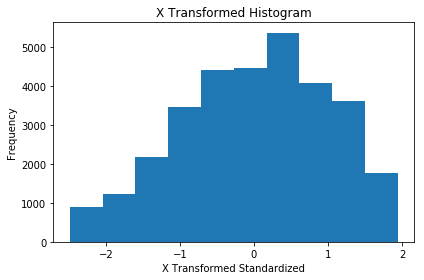

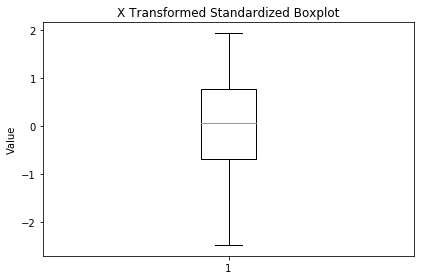

11.4044971656
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[ 105.29445549  112.60328613   65.6092476  ...,   99.4159687     0.
   62.70208767]
[ 1.19117273  1.47973481 -0.37565051 ...,  0.95908249 -2.96598832
 -0.49042894]
X
number of instances:  31454
minimum:  -0.0
Q1:  0.767518720657
median:  0.80947865584
mean:  0.798051978649
Q3:  0.843898939786
maximum:  0.928574527856
standard deviation:  0.0625851846467
skewness:  -1.223032208839771


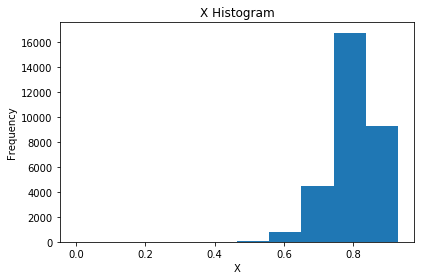

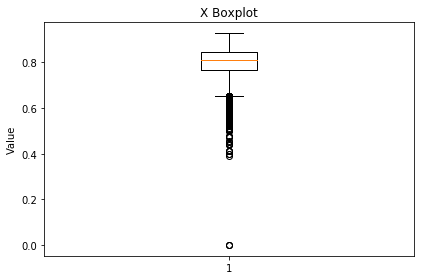

X Standardized
number of instances:  31454
minimum:  -12.7514520114
Q1:  -0.487867187165
median:  0.182577989602
mean:  4.04811020055e-16
Q3:  0.732552941975
maximum:  2.08551832105
standard deviation:  1.0
skewness:  -1.223032208839772


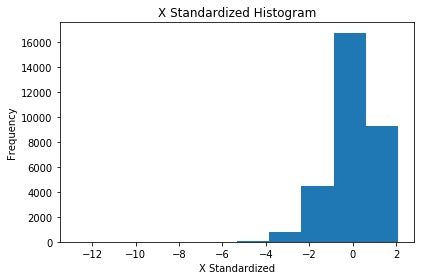

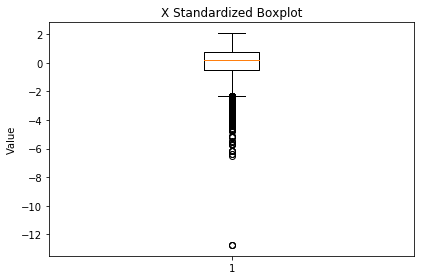

X Transformed
number of instances:  31454
minimum:  0.0
Q1:  57.9869049421
median:  75.8035495295
mean:  75.1238937329
Q3:  93.99767046
maximum:  156.913118728
standard deviation:  25.3284522747
skewness:  -0.07956778643106442


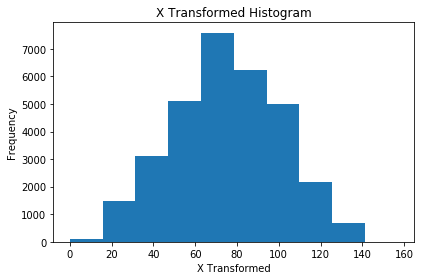

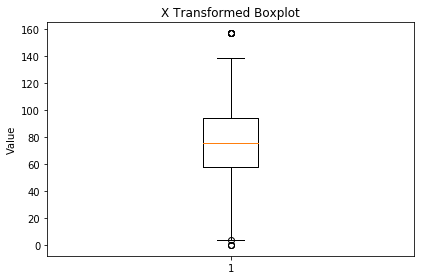

X Transformed Standardized
number of instances:  31454
minimum:  -2.96598832484
Q1:  -0.676590444809
median:  0.0268336884257
mean:  -3.90353483625e-16
Q3:  0.745161075081
maximum:  3.22914420936
standard deviation:  1.0
skewness:  -0.07956778643106309


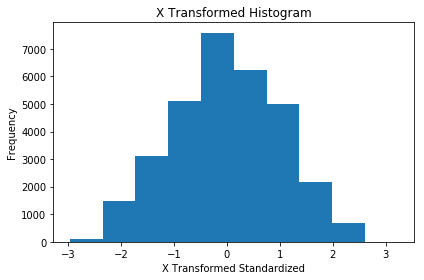

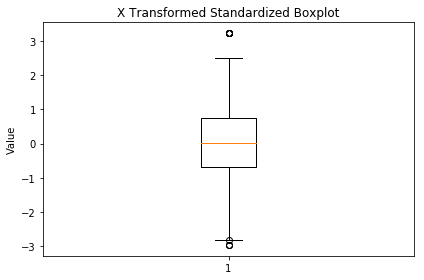

0.0686299770932
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[ 16.93181177  18.23715717  22.40449821 ...,  15.80434841   0.          24.09796693]
[-0.12230348  0.21906741  1.30890073 ..., -0.41715507 -4.55027143
  1.75177272]
X
number of instances:  31454
minimum:  0.0
Q1:  24702.0
median:  85450.0
mean:  277622.460069
Q3:  347434.0
maximum:  2569036.0
standard deviation:  394824.510952
skewness:  1.9303897595526154


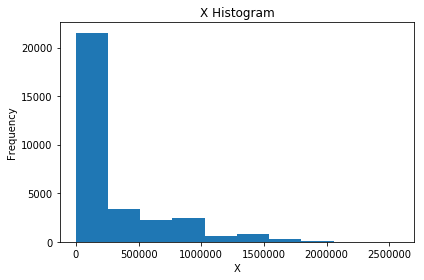

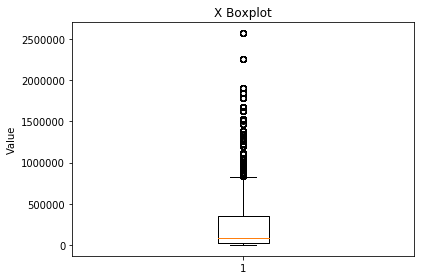

X Standardized
number of instances:  31454
minimum:  -0.703154065586
Q1:  -0.640589560813
median:  -0.486728799095
mean:  -7.22876821527e-17
Q3:  0.176816631174
maximum:  5.80362534841
standard deviation:  1.0
skewness:  1.9303897595526154


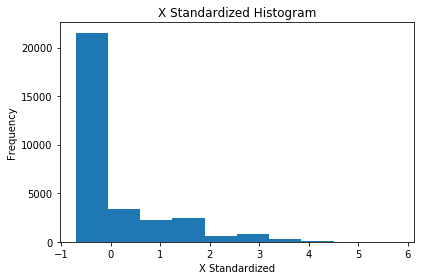

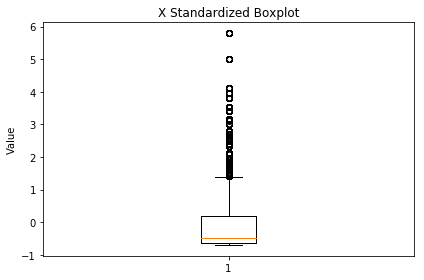

X Transformed
number of instances:  31454
minimum:  0.0
Q1:  14.6007216233
median:  17.1941751617
mean:  17.3994798988
Q3:  20.4039828503
maximum:  25.551658883
standard deviation:  3.82383340347
skewness:  -0.03197219636001762


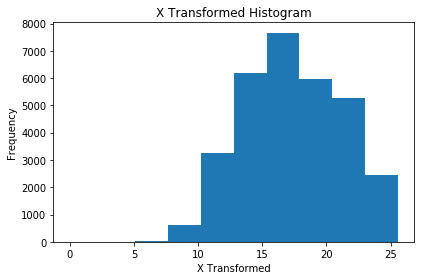

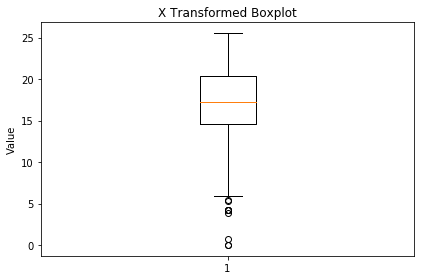

X Transformed Standardized
number of instances:  31454
minimum:  -4.55027143259
Q1:  -0.731924741527
median:  -0.0536908163621
mean:  8.09622040111e-16
Q3:  0.785730609691
maximum:  2.1319388488
standard deviation:  1.0
skewness:  -0.03197219636002021


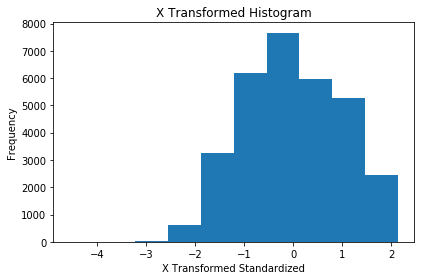

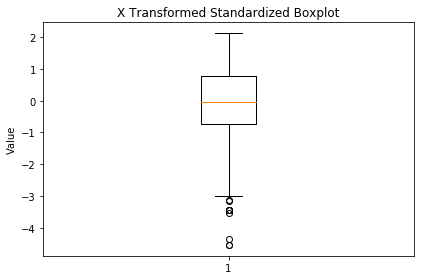

5.23630329911
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[ 6869095.68334831  1149270.4717887   7798432.64838848 ...,
  6370016.19170551        0.          8886772.25271291]
[ 0.34535439 -2.4578177   0.80080387 ...,  0.1007655  -3.0210522
  1.33417737]
X
number of instances:  31454
minimum:  0.0
Q1:  24.9369968224
median:  26.2141578783
mean:  25.8741092332
Q3:  27.2557366061
maximum:  29.9473412
standard deviation:  2.08106180891
skewness:  -2.2566964243197143


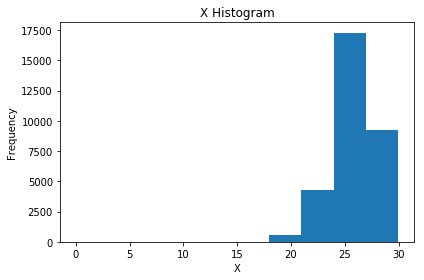

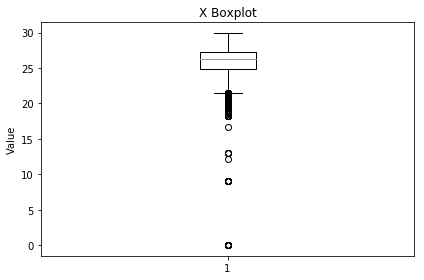

X Standardized
number of instances:  31454
minimum:  -12.4331286666
Q1:  -0.450304938929
median:  0.163401511482
mean:  -2.60597094161e-15
Q3:  0.663905015675
maximum:  1.95728543447
standard deviation:  1.0
skewness:  -2.2566964243197063


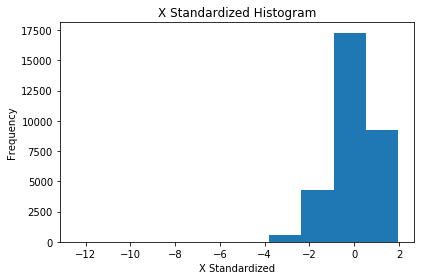

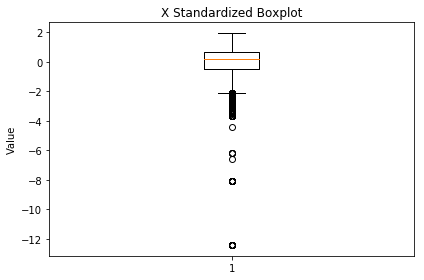

X Transformed
number of instances:  31454
minimum:  0.0
Q1:  4838241.25341
median:  6222952.13896
mean:  6164405.90069
Q3:  7575471.13125
maximum:  12199193.7396
standard deviation:  2040483.0813
skewness:  -0.10758091992856228


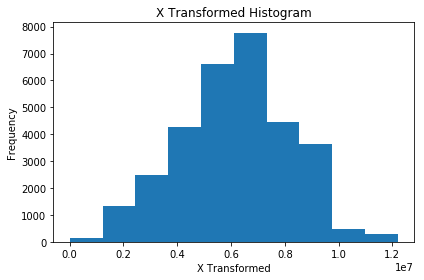

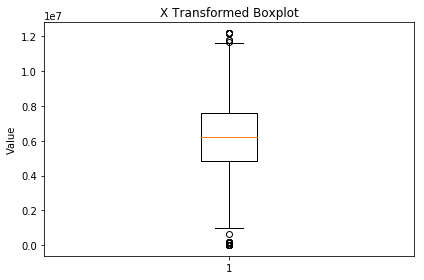

X Transformed Standardized
number of instances:  31454
minimum:  -3.02105219944
Q1:  -0.649926803822
median:  0.0286923419287
mean:  3.68667178979e-16
Q3:  0.691534883816
maximum:  2.95752897644
standard deviation:  1.0
skewness:  -0.10758091992856358


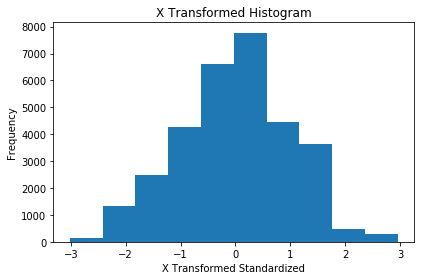

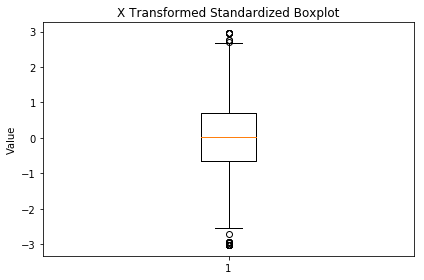

In [49]:
# census variables (objective)
data['poverty_frac_ts'] = helpers.analyse_and_transform(data['poverty_fr'].apply(helpers.mk_number))
data['black_frac_ts'] = helpers.analyse_and_transform(data['black_frac'].apply(helpers.mk_number))
data['hispanic_frac_ts'] = helpers.analyse_and_transform(data['hispanic_f'].apply(helpers.mk_number))
data['assaults_ts'] = helpers.analyse_and_transform(data['assaults_2'].apply(helpers.mk_number))
data['rented_frac_ts'] = helpers.analyse_and_transform(data['rented_fra'].apply(helpers.mk_number))

# social media variables (more subjective)
data['venues_index_ts'] = helpers.analyse_and_transform(data['venues_ind'].apply(helpers.mk_number))
data['checkins_ts'] = helpers.analyse_and_transform(data['checkins_t'].apply(helpers.mk_number))
data['avg_qscore_ts'] = helpers.analyse_and_transform(data['avg_qscore'].apply(helpers.mk_number))

*** Prepare the right data types for the regressions following ***

In [50]:
y_final = np.array(data['price_log'])
print(type(y_final))
print(y_final.shape)
y_name = 'log-transformed price'

x_final = data[[
'room_type','accomodate','bathrooms','bedroom_type',
        
'poverty_frac_ts',
'black_frac_ts',
'hispanic_frac_ts',
'assaults_ts',
'rented_frac_ts',
        
'venues_index_ts',  
'checkins_ts',
'avg_qscore_ts',
]]
print(type(x_final))
print(x_final.shape)

cols=x_final.columns.tolist()
feature_names = cols[:]
print('only features: ', feature_names)
print('dependent variable: ', y_name)

<class 'numpy.ndarray'>
(31454,)
<class 'pandas.core.frame.DataFrame'>
(31454, 12)
only features:  ['room_type', 'accomodate', 'bathrooms', 'bedroom_type', 'poverty_frac_ts', 'black_frac_ts', 'hispanic_frac_ts', 'assaults_ts', 'rented_frac_ts', 'venues_index_ts', 'checkins_ts', 'avg_qscore_ts']
dependent variable:  log-transformed price


** Test correlations of dependent variable with the independent variables **

In [51]:
## lets have a look at the Pearson correlations to understand whether there are any strong relationships
X = np.array(x_final)
Xy = np.vstack((X.T, np.atleast_2d(y_final)))
#print(Xy)

correlations = np.corrcoef(Xy)[-1, :]
c = 0 
for feature_name, correlation in zip(feature_names, correlations):
    p = float(sp.stats.pearsonr(X[0:,c], y_final)[1])
    if (p <= 0.001):
        print (c, '{0:>10} {1:+.4f}'.format(feature_name, correlation), '***'.format(p))
    else:
        if (p <= 0.01):
            print (c, '{0:>10} {1:+.4f}'.format(feature_name, correlation), '**'.format(p))
        else:
            if (p <= 0.05):
                print (c, '{0:>10} {1:+.4f}'.format(feature_name, correlation), '*'.format(p))
            else:
                print ('NOT'.format(p), c, '{0:>10} {1:+.4f}'.format(feature_name, correlation))#, '(p={0:+.4f})'.format(p)
    c+=1
print('{0:>10} {1:+.4f}'.format('y', correlations[-1]))

0  room_type +0.6605 ***
1 accomodate +0.5642 ***
2  bathrooms +0.1966 ***
3 bedroom_type +0.1000 ***
4 poverty_frac_ts -0.3046 ***
5 black_frac_ts -0.2577 ***
6 hispanic_frac_ts -0.3050 ***
7 assaults_ts -0.1046 ***
8 rented_frac_ts -0.1124 ***
9 venues_index_ts +0.1554 ***
10 checkins_ts +0.4643 ***
11 avg_qscore_ts +0.0675 ***
         y +1.0000


** Build proximity matrix (this time based on nearest neighbors) **

In [52]:
airbnbW = ps.knnW_from_shapefile(airbnb_shp_link, k=10)

**Test for global spatial auto-correlation**

In [53]:
I = ps.Moran(y_final, airbnbW)
I.I, I.p_sim

(0.33120102272331814, 0.001)

**Finally, build the models. Start with simple OLS and diagnostics.**

In [54]:
airbnb_model_ols = ps.spreg.OLS(y=y_final[:, None], \
                         x=x_final.values, \
                         w=airbnbW, \
                         name_y=y_name, \
                         name_x=feature_names, \
                         spat_diag=True)
print(airbnb_model_ols.summary)

REGRESSION
----------
SUMMARY OF OUTPUT: ORDINARY LEAST SQUARES
-----------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :log-transformed price                Number of Observations:       31454
Mean dependent var  :      4.7136                Number of Variables   :          13
S.D. dependent var  :      0.6401                Degrees of Freedom    :       31441
R-squared           :      0.6609
Adjusted R-squared  :      0.6608
Sum squared residual:    4370.039                F-statistic           :   5106.5160
Sigma-square        :       0.139                Prob(F-statistic)     :           0
S.E. of regression  :       0.373                Log likelihood        :  -13590.059
Sigma-square ML     :       0.139                Akaike info criterion :   27206.119
S.E of regression ML:      0.3727                Schwarz criterion     :   27314.751

--------------------------------------------------------------------

***Continue with spatial models (which one?)***

In [55]:
airbnb_model_combo = ps.spreg.GM_Combo(y=y_final[:, None], \
                         x=x_final.values, \
                         w=airbnbW, \
                         name_y=y_name, \
                         name_x=feature_names)
print(airbnb_model_combo.summary)

REGRESSION
----------
SUMMARY OF OUTPUT: SPATIALLY WEIGHTED TWO STAGE LEAST SQUARES
-------------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :log-transformed price                Number of Observations:       31454
Mean dependent var  :      4.7136                Number of Variables   :          14
S.D. dependent var  :      0.6401                Degrees of Freedom    :       31440
Pseudo R-squared    :      0.6769
Spatial Pseudo R-squared:  0.6637

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTANT       2.8578782       0.0595468      47.9938566       0.0000000
           room_type       0.5076191       0.0049858     101.8133889       0.0000000
          accomodate       0

*** Asses prediction performance of spatial models***

In [56]:
from sklearn.metrics import mean_squared_error as mse

mses = pd.Series({'OLS': mse(y_final, airbnb_model_ols.predy.flatten()), \
                  'Combo': mse(y_final, airbnb_model_combo.predy.flatten())
                    })
mses.sort_values()

Combo    0.132390
OLS      0.138934
dtype: float64